## Sim Demo

### Imports

In [8]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
from env.imports import *

In [10]:
# overall imports
import importlib
import data
import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

#### Check job specs

In [11]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 1.3%
RAM Usage: 3.9%
Available RAM: 968.1G
Total RAM: 1007.0G
52.4G


In [12]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))
os.environ["CUDA_VISIBLE_DEVICES"] = "0,1"

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0,1
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB


In [13]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [14]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

Random

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 6, 'binarize': False}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0259
Best val loss so far at epoch 2: 0.0229
Best val loss so far at epoch 4: 0.0225
Epoch 5/100, Train Loss: 0.0203, Val Loss: 0.0225
Best val loss so far at epoch 5: 0.0225
Best val loss so far at epoch 6: 0.0212
Best val loss so far at epoch 7: 0.0209
Best val loss so far at epoch 9: 0.0209
Epoch 10/100, Train Loss: 0.0178, Val Loss: 0.0206
Best val loss so far at epoch 10: 0.0206
Best val loss so far at epoch 13: 0.0203
Best val loss so far at epoch 14: 0.0201
Epoch 15/100, Train Loss: 0.0166, Val Loss: 0.0208
Epoch 20/100, Train Loss: 0.0159, Val Loss: 0.0210
Best val loss so far at epoch 22: 0.0199
Epoch 25/100, Train Loss: 0.0154, Val Loss: 0.0202
Best val loss so far at epoch 27: 0.0192
Best val loss so far at epoch 28: 0.0191
Epoch 30/100, Train Loss: 0.0149, Val Loss: 0.

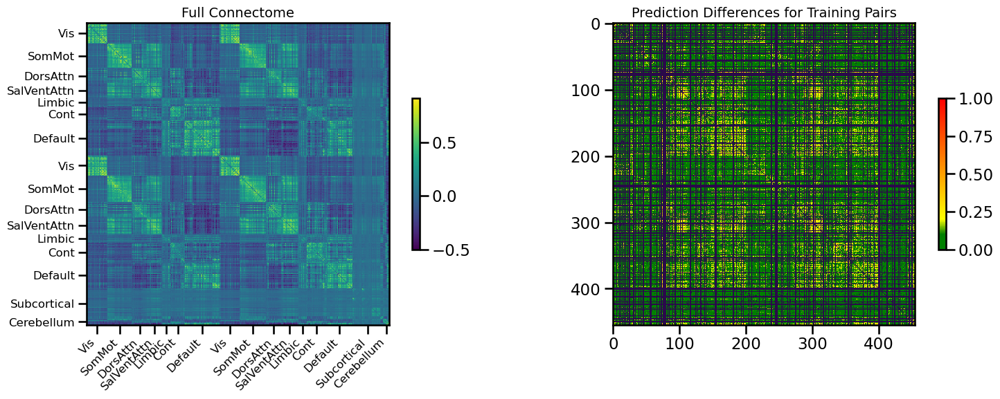

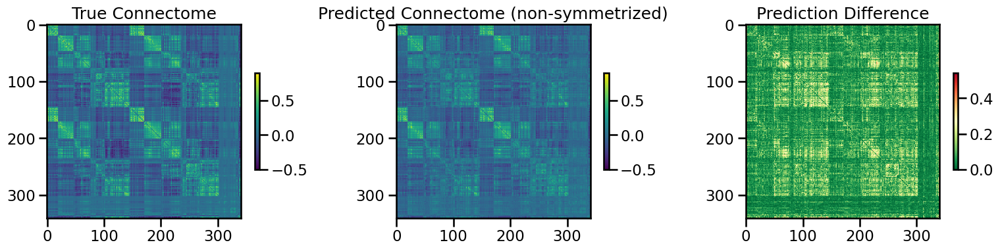

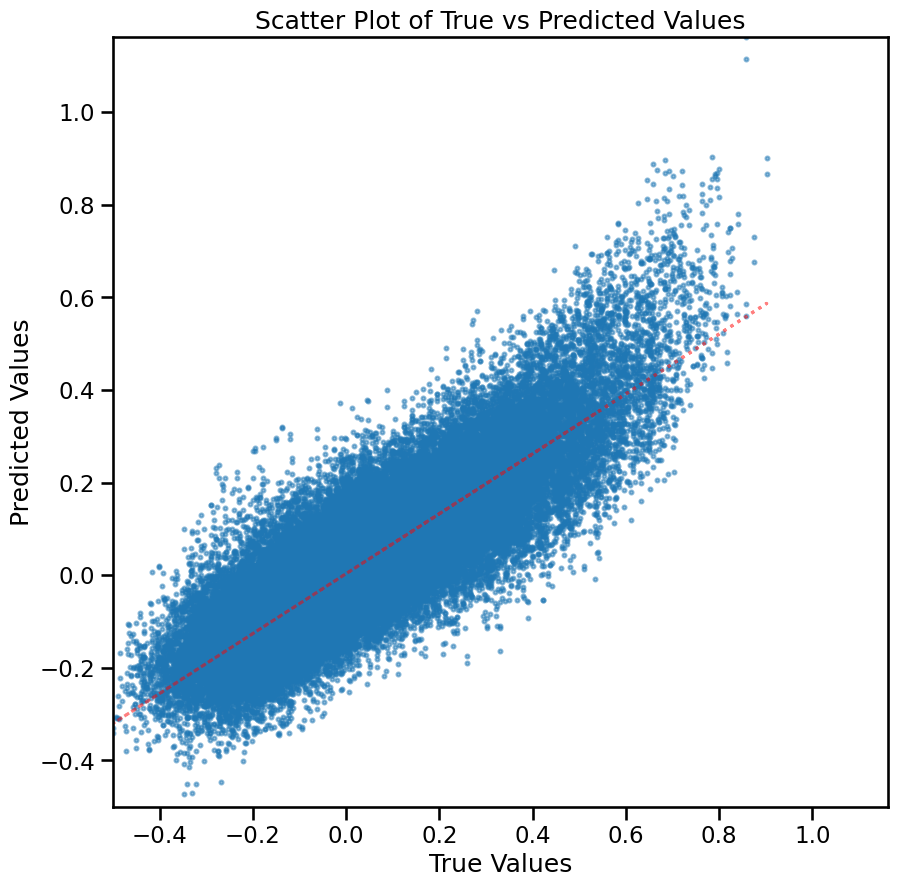

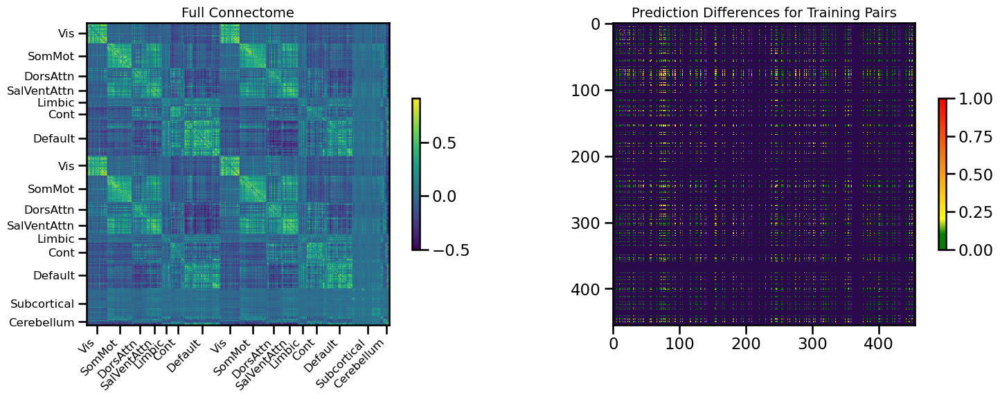

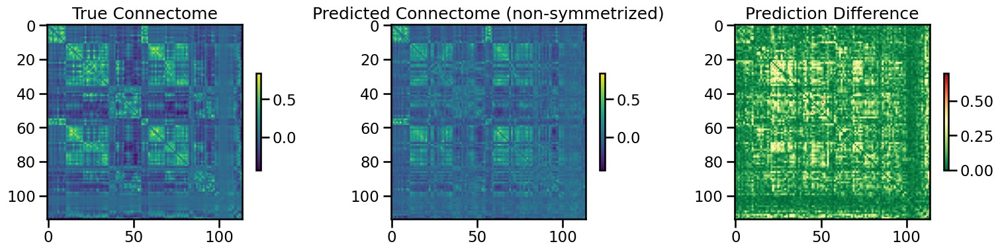

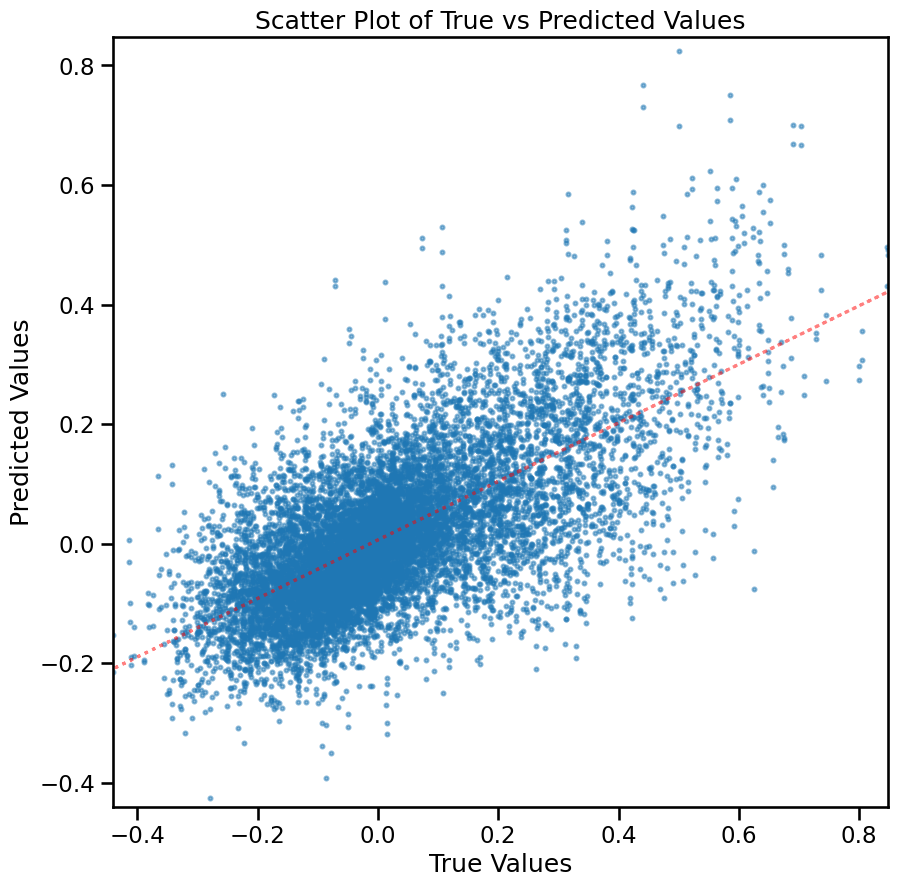

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.009798811, 'mae': 0.07284644, 'r2': 0.7107448509468925, 'pearson_corr': 0.8473843755803483, 'geodesic_distance': 21.871105050964882}
TEST METRICS: {'mse': 0.017535334, 'mae': 0.09695143, 'r2': 0.4643932757854279, 'pearson_corr': 0.6831264004817673, 'geodesic_distance': 13.959756743605473}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.0, 'learning_rate': 0.001, 'weight_decay': 0.0, 'batch_size': 64, 'epochs': 100}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▅▄▄▃▄▄▃▄▃▃▃▃▂▃▂▂▁▁▁▂▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▆▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01765
train_mse_loss,0.01181


Final evaluation metrics logged successfully.


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 6, 'binarize': False}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0262
Best val loss so far at epoch 2: 0.0256
Best val loss so far at epoch 3: 0.0250
Best val loss so far at epoch 4: 0.0237
Epoch 5/100, Train Loss: 0.0200, Val Loss: 0.0219
Best val loss so far at epoch 5: 0.0219
Best val loss so far at epoch 9: 0.0210
Epoch 10/100, Train Loss: 0.0178, Val Loss: 0.0206
Best val loss so far at epoch 10: 0.0206
Best val loss so far at epoch 14: 0.0204
Epoch 15/100, Train Loss: 0.0167, Val Loss: 0.0205
Best val loss so far at epoch 17: 0.0200
Best val loss so far at epoch 18: 0.0195
Epoch 20/100, Train Loss: 0.0159, Val Loss: 0.0194
Best val loss so far at epoch 20: 0.0194
Best val loss so far at epoch 24: 0.0194
Epoch 25/100, Train Loss: 0.0154, Val Loss: 0.0199
Best val loss so far at epoch 26: 0.0187
Epoch 30/100, Train Loss: 0.0150, Val Loss: 0

In [ ]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'euclidean': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0318
Best val loss so far at epoch 2: 0.0310
Best val loss so far at epoch 3: 0.0263
Best val loss so far at epoch 4: 0.0237
Epoch 5/100, Train Loss: 0.0436, Val Loss: 0.0209
Best val loss so far at epoch 5: 0.0209
Best val loss so far at epoch 6: 0.0206
Best val loss so far at epoch 7: 0.0186
Best val loss so far at epoch 8: 0.0174
Epoch 10/100, Train Loss: 0.0153, Val Loss: 0.0176
Best val loss so far at epoch 14: 0.0162
Epoch 15/100, Train Loss: 0.0101, Val Loss: 0.0184
Best val loss so far at epoch 16: 0.0161
Best val loss so far at epoch 18: 0.0151
Epoch 20/100, Train Loss: 0.0081, Val Loss: 0.0168
Epoch 25/100, Train Loss: 0.0071, Val Loss: 0.0165
Epoch 30/100, Train Loss: 0.0066, Val Loss: 0.0154
Best val loss so far at epoch 32: 0.0150

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.022140
Epoch 35/100, Train Loss: 0.0062, 

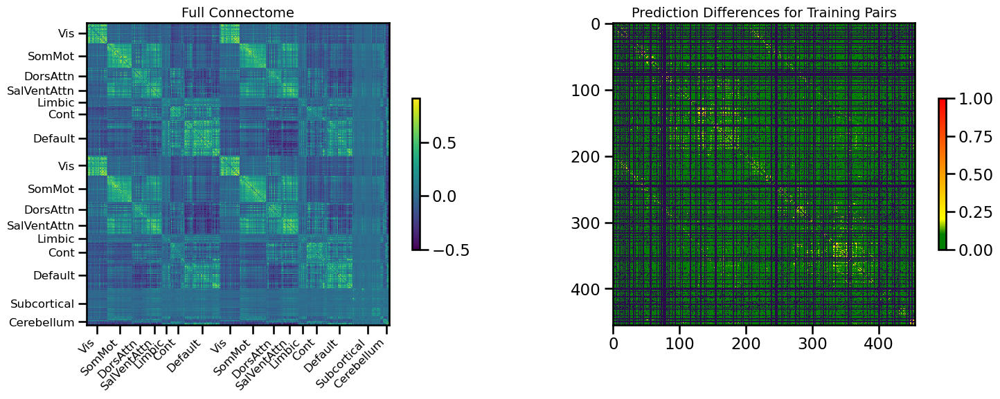

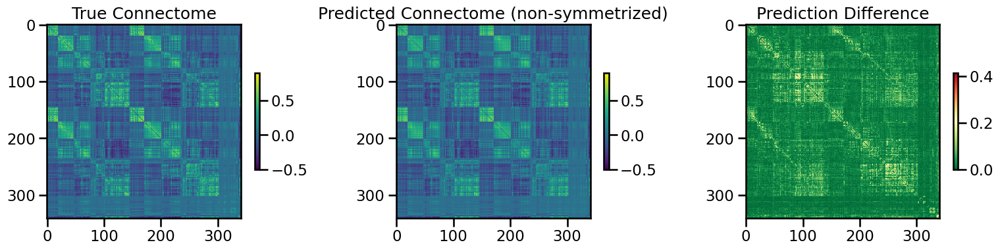

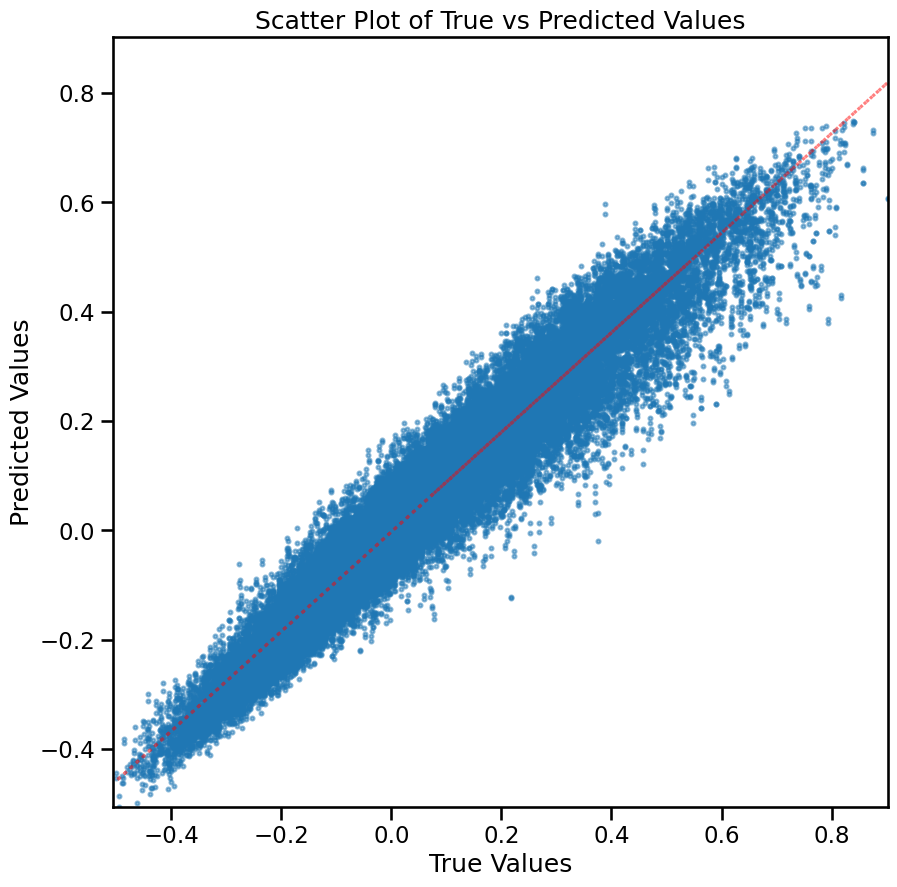

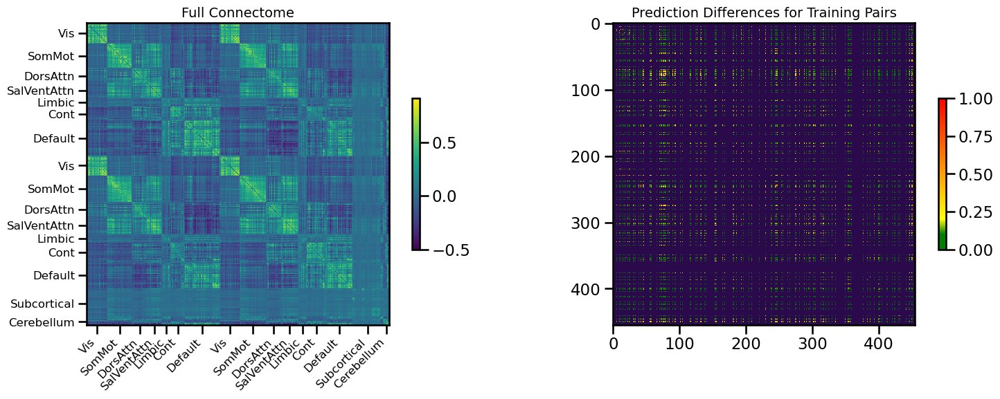

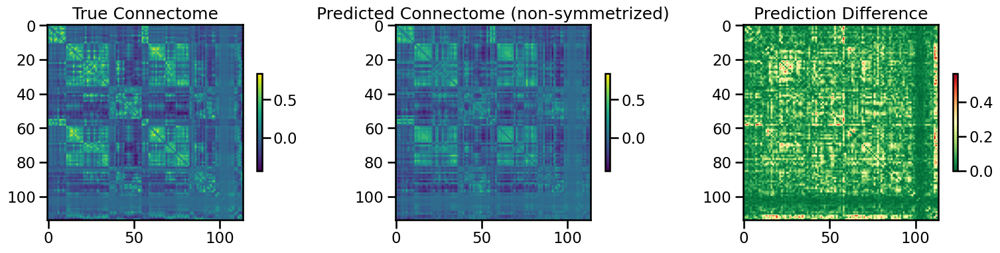

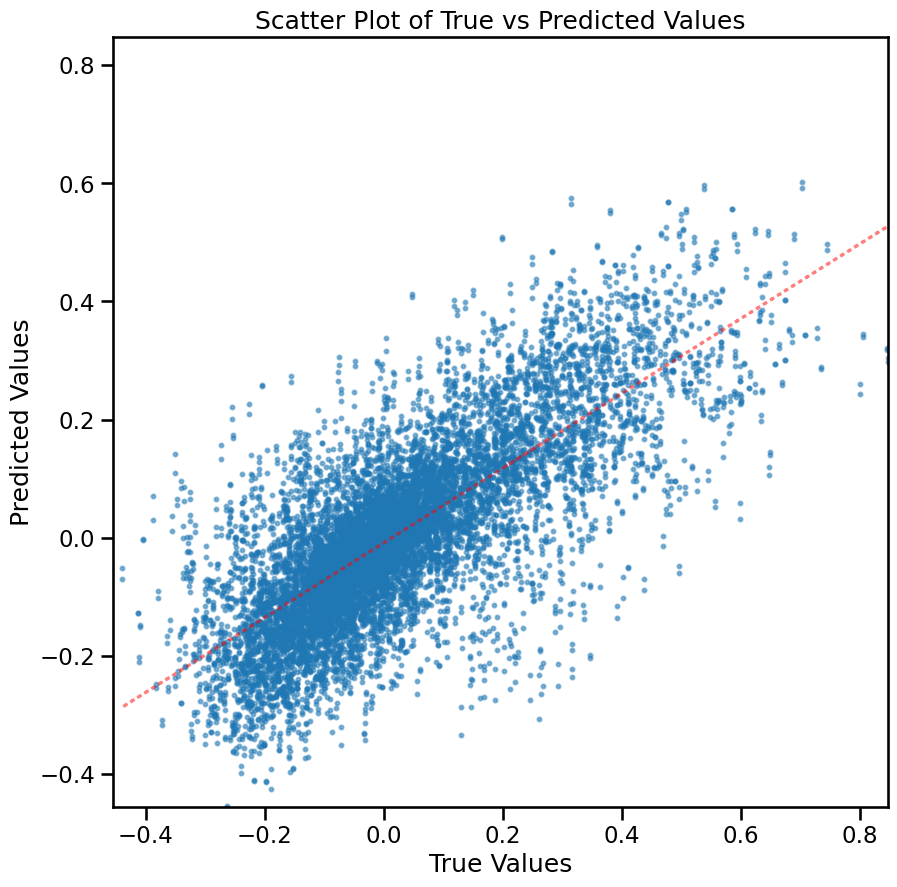

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0020796193, 'mae': 0.031069467, 'r2': 0.938610863571861, 'pearson_corr': 0.969566250757978, 'geodesic_distance': 17.10940073857754}
TEST METRICS: {'mse': 0.014252728, 'mae': 0.08394544, 'r2': 0.5646586108467497, 'pearson_corr': 0.7608114933104312, 'geodesic_distance': 12.331052922649667}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▅▃▄▅▆▂▄▂▂▂▃▂▂▃▅▃▂▂▅▃▆▁▁▂▂▁▂▁▁▂▂▁▂▃▂▁▁▁
train_mse_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01416
train_mse_loss,0.00439


Final evaluation metrics logged successfully.


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0351
Best val loss so far at epoch 2: 0.0290
Best val loss so far at epoch 3: 0.0266
Best val loss so far at epoch 4: 0.0261
Epoch 5/100, Train Loss: 0.0414, Val Loss: 0.0221
Best val loss so far at epoch 5: 0.0221
Best val loss so far at epoch 6: 0.0211
Best val loss so far at epoch 7: 0.0192
Best val loss so far at epoch 8: 0.0181
Epoch 10/100, Train Loss: 0.0150, Val Loss: 0.0212
Best val loss so far at epoch 13: 0.0157
Epoch 15/100, Train Loss: 0.0095, Val Loss: 0.0179
Best val loss so far at epoch 16: 0.0157
Epoch 20/100, Train Loss: 0.0078, Val Loss: 0.0267
Best val loss so far at epoch 24: 0.0145
Epoch 25/100, Train Loss: 0.0069, Val Loss: 

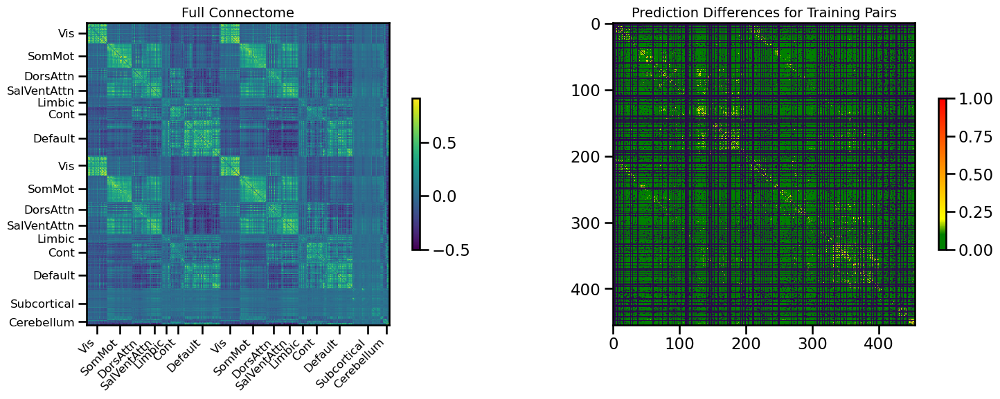

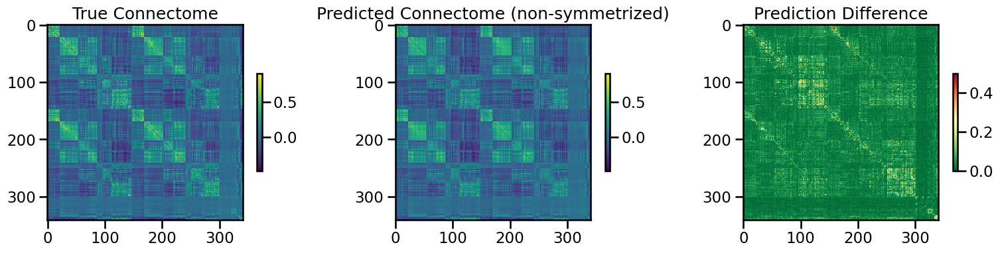

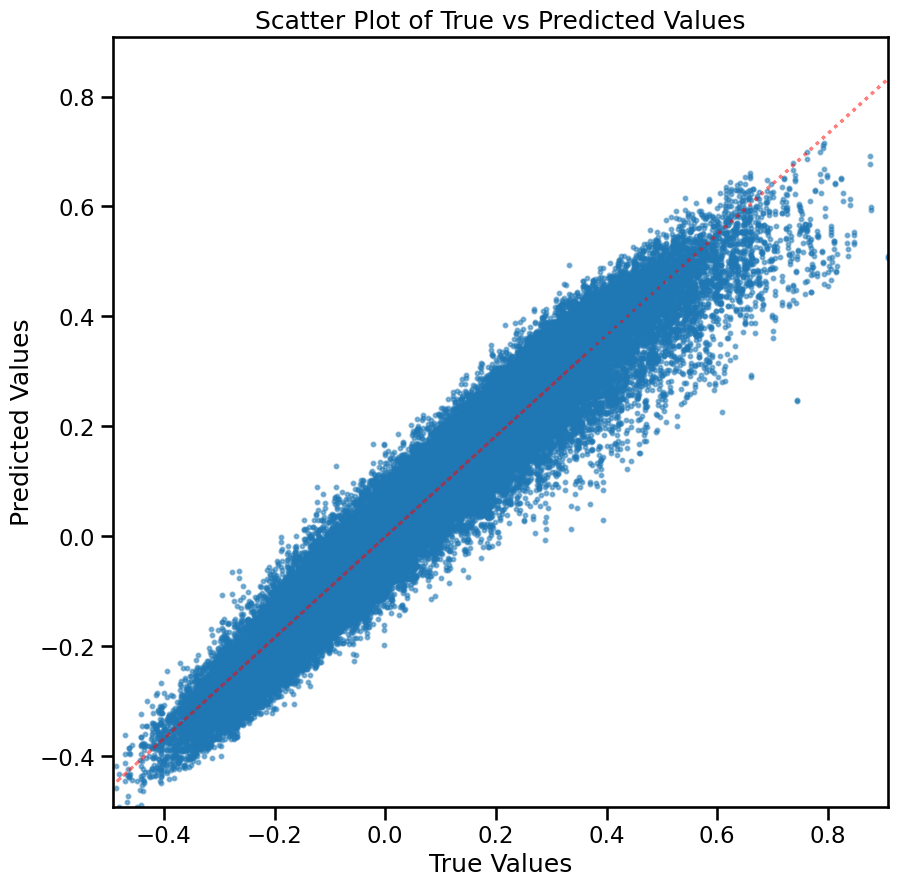

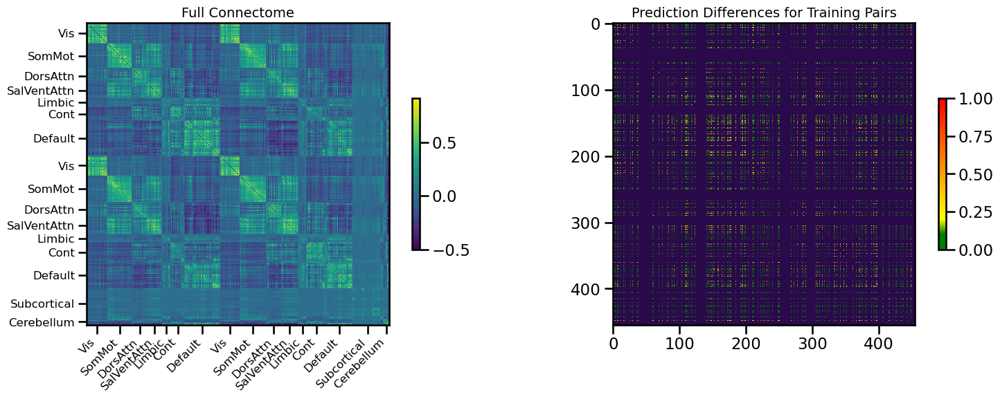

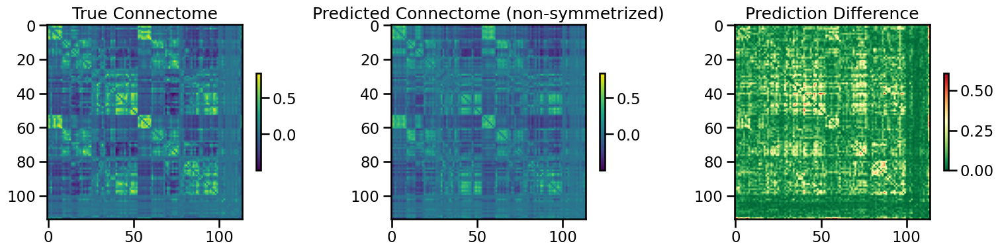

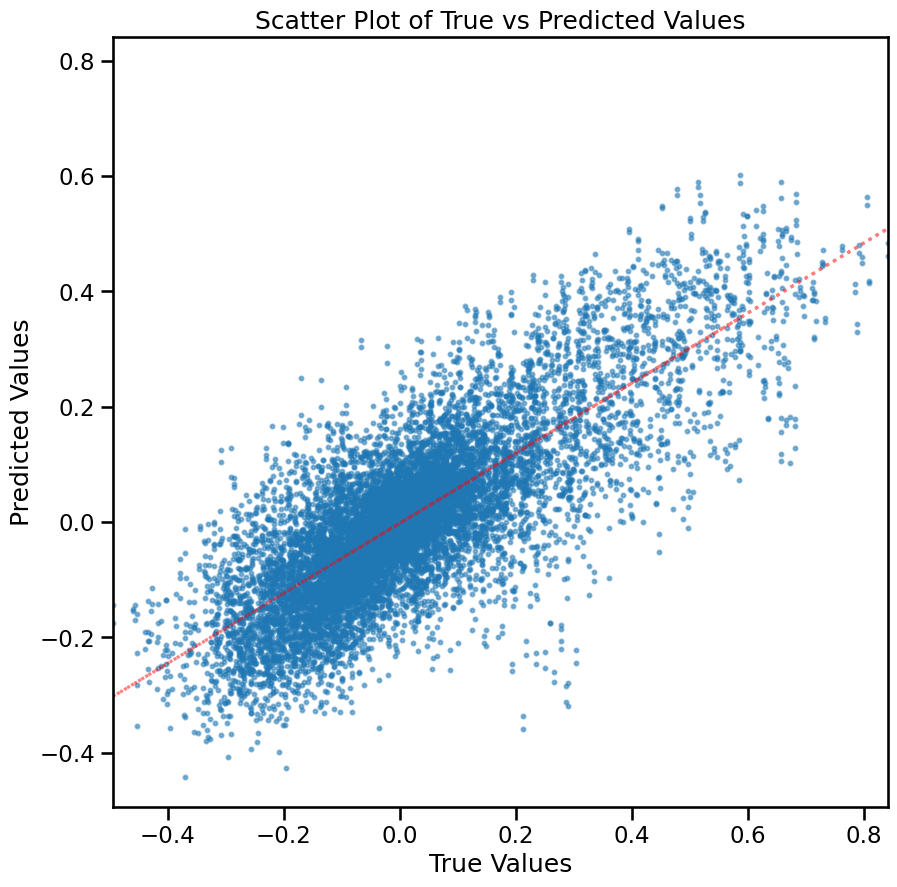

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0021317247, 'mae': 0.03247816, 'r2': 0.9359523452708295, 'pearson_corr': 0.9677572524698754, 'geodesic_distance': 17.8251675604944}
TEST METRICS: {'mse': 0.013479459, 'mae': 0.08313919, 'r2': 0.6153640912353713, 'pearson_corr': 0.7857602119605644, 'geodesic_distance': 11.773698737252385}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▄▄▃▄▃▃▂▂▃▂▃▂▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▆▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.0131
train_mse_loss,0.00417


Final evaluation metrics logged successfully.


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0327
Best val loss so far at epoch 2: 0.0297
Best val loss so far at epoch 3: 0.0246
Best val loss so far at epoch 4: 0.0221
Epoch 5/100, Train Loss: 0.0489, Val Loss: 0.0215
Best val loss so far at epoch 5: 0.0215
Best val loss so far at epoch 7: 0.0193
Best val loss so far at epoch 8: 0.0183
Best val loss so far at epoch 9: 0.0181
Epoch 10/100, Train Loss: 0.0169, Val Loss: 0.0161
Best val loss so far at epoch 10: 0.0161
Best val loss so far at epoch 12: 0.0158
Epoch 15/100, Train Loss: 0.0102, Val Loss: 0.0168
Epoch 20/100, Train Loss: 0.0082, Val Loss: 0.0221
Epoch 25/100, Train Loss: 0.0072, Val Loss: 0.0171
Epoch 30/100, Train Loss: 0.0066, 

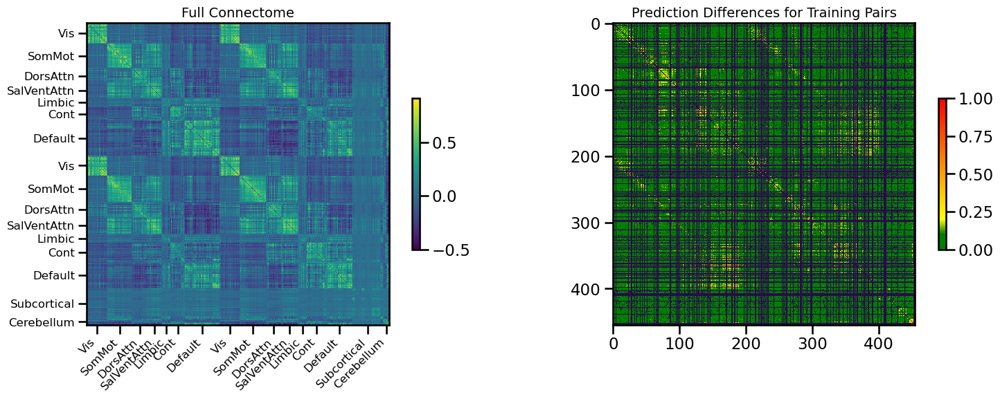

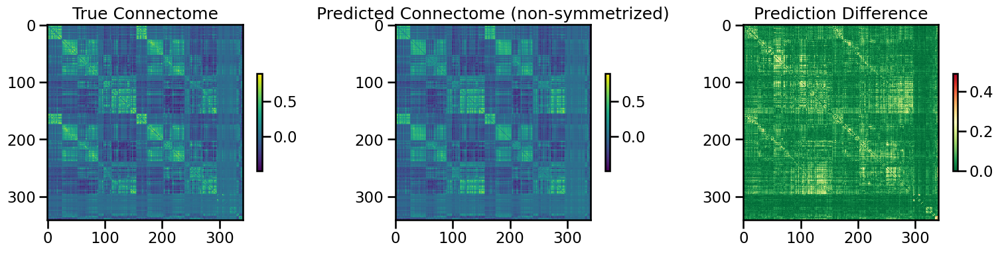

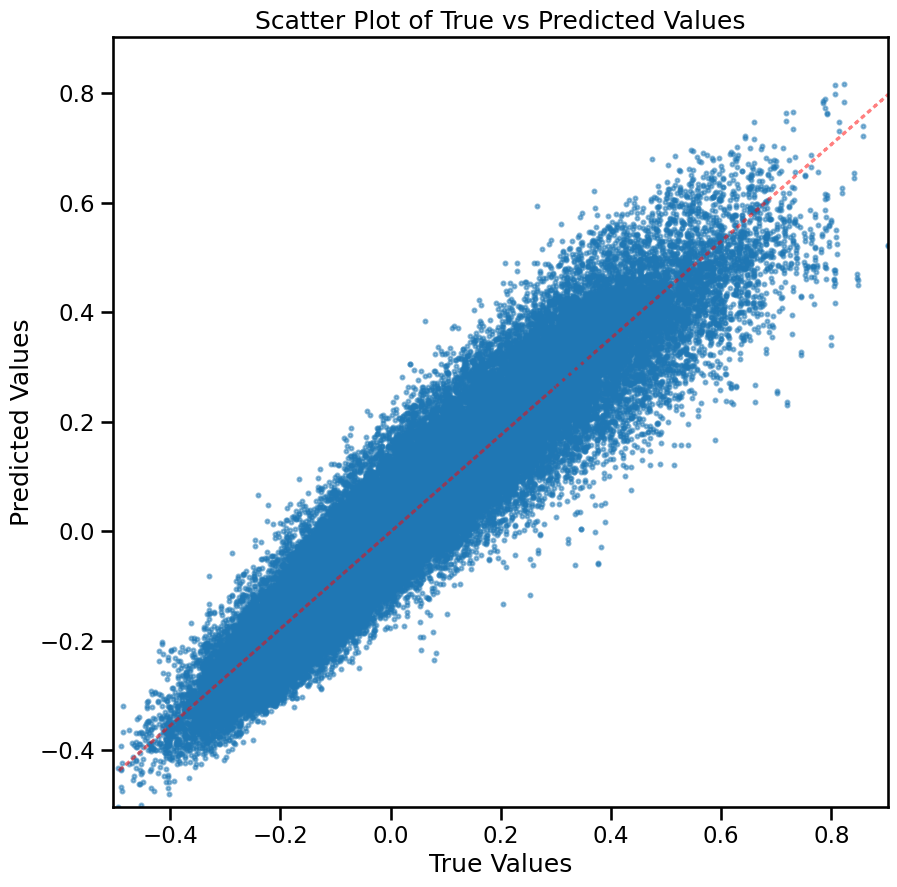

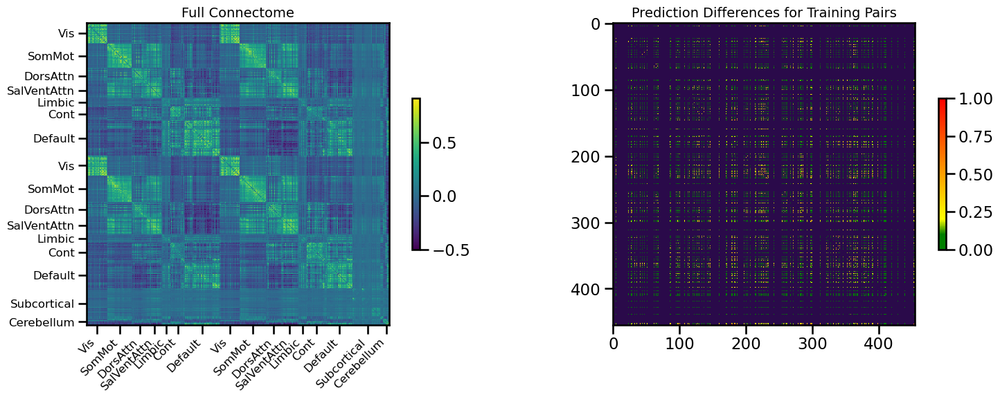

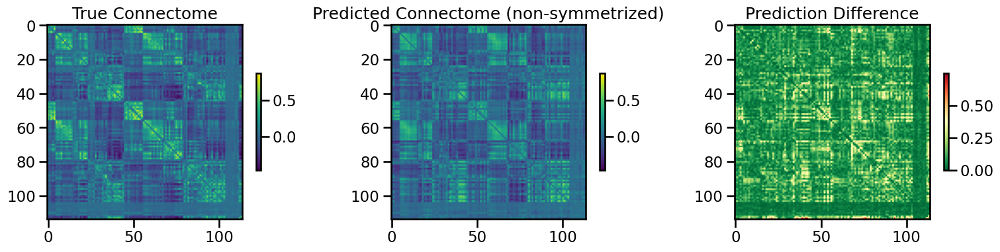

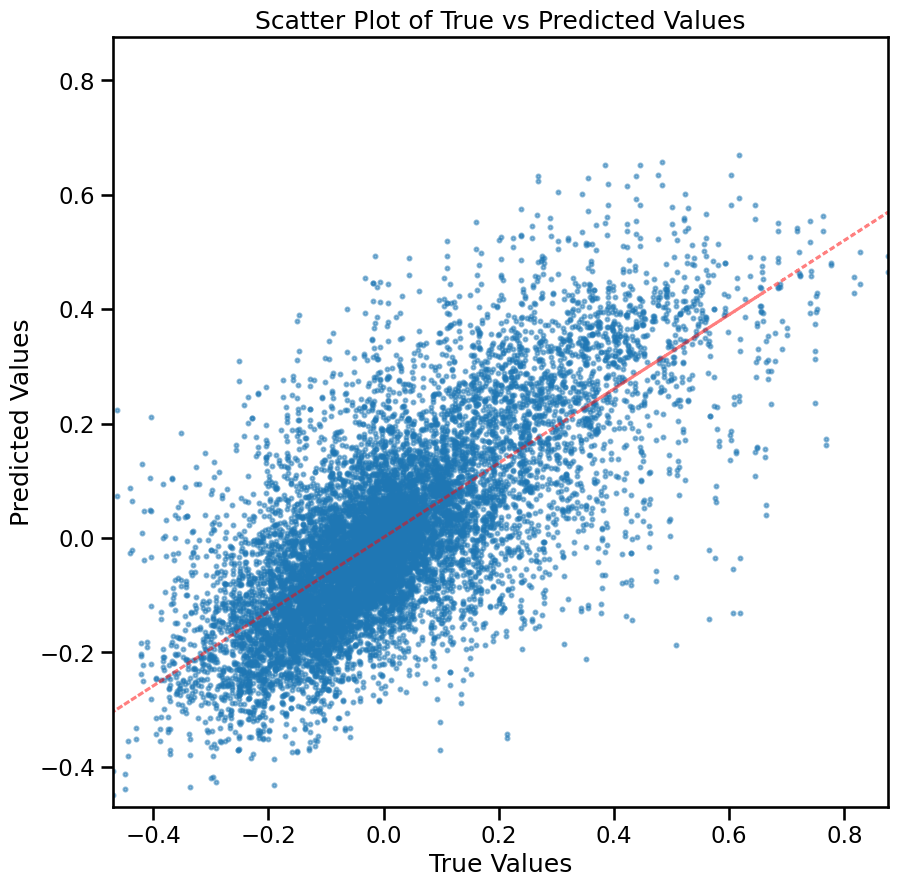

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.003694377, 'mae': 0.04384283, 'r2': 0.888459768044334, 'pearson_corr': 0.9427710127677901, 'geodesic_distance': 18.469769344481318}
TEST METRICS: {'mse': 0.016934235, 'mae': 0.09353537, 'r2': 0.5012865899878569, 'pearson_corr': 0.727320049815004, 'geodesic_distance': 12.046278007414003}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▅▄▄▃▂▂▃▂▅▂▂▂▂▄▃▆▂▃▃▃▄▃▁▁▁▂▁▂▂▁▂▁▁▁▂▂▂▂
train_mse_loss,█▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01672
train_mse_loss,0.00493


Final evaluation metrics logged successfully.


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0364
Best val loss so far at epoch 2: 0.0234
Best val loss so far at epoch 3: 0.0225
Best val loss so far at epoch 4: 0.0204
Epoch 5/100, Train Loss: 0.0402, Val Loss: 0.0206
Best val loss so far at epoch 6: 0.0189
Best val loss so far at epoch 8: 0.0182
Epoch 10/100, Train Loss: 0.0138, Val Loss: 0.0171
Best val loss so far at epoch 10: 0.0171
Best val loss so far at epoch 13: 0.0166
Epoch 15/100, Train Loss: 0.0093, Val Loss: 0.0173
Epoch 20/100, Train Loss: 0.0077, Val Loss: 0.0161
Best val loss so far at epoch 20: 0.0161
Best val loss so far at epoch 23: 0.0158
Epoch 25/100, Train Loss: 0.0069, Val Loss: 0.0186
Epoch 30/100, Train Loss: 0.0065

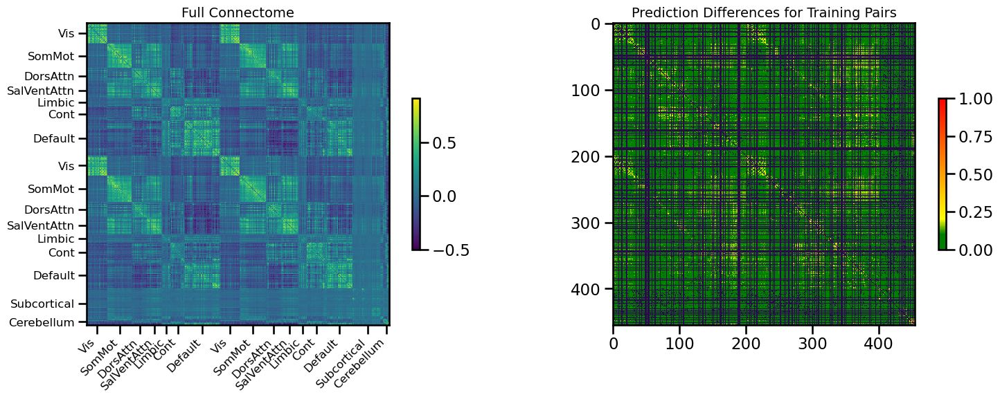

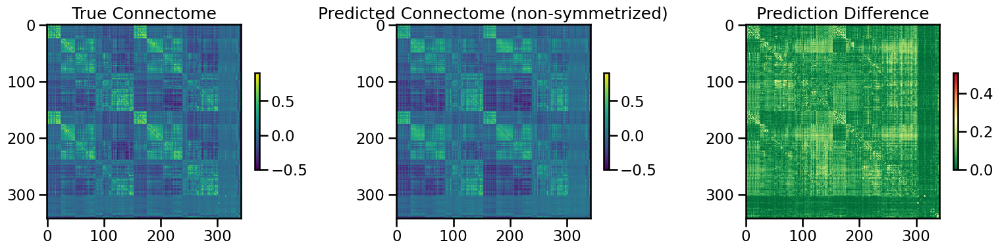

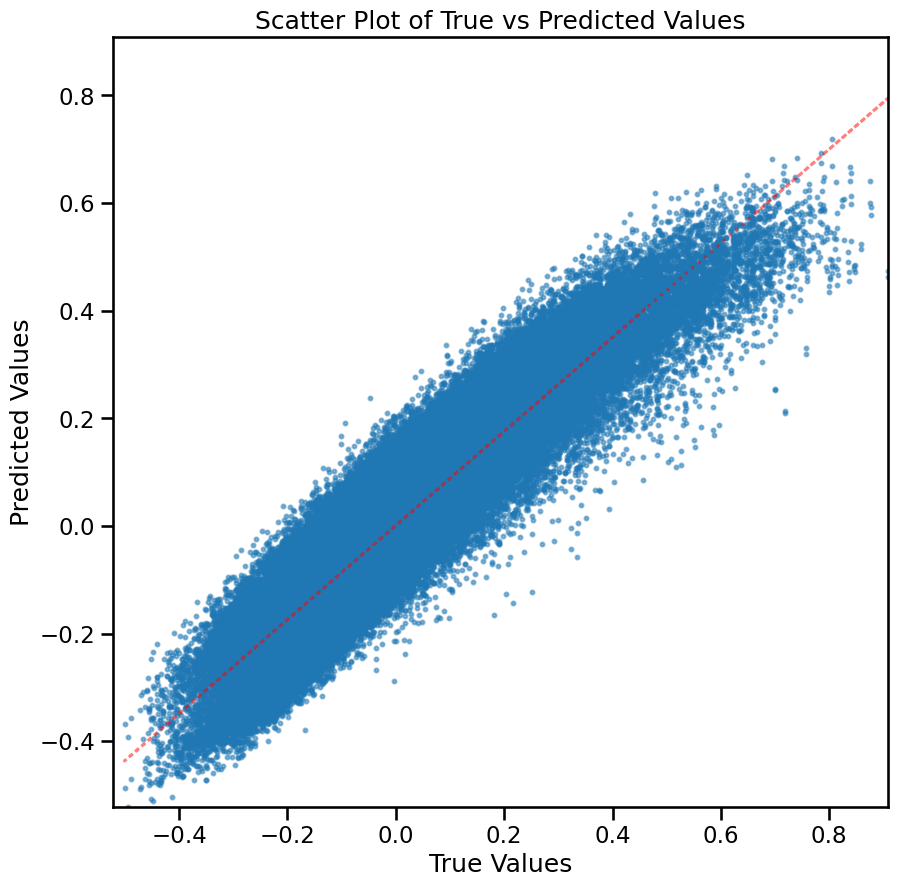

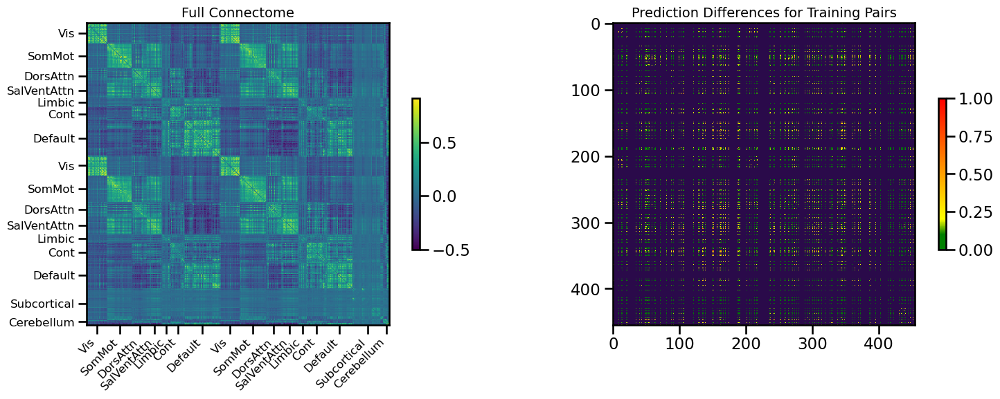

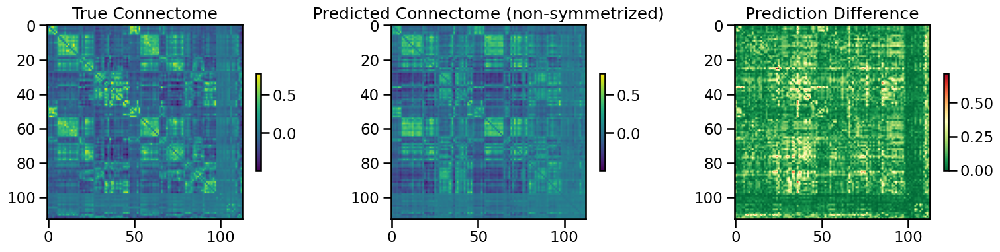

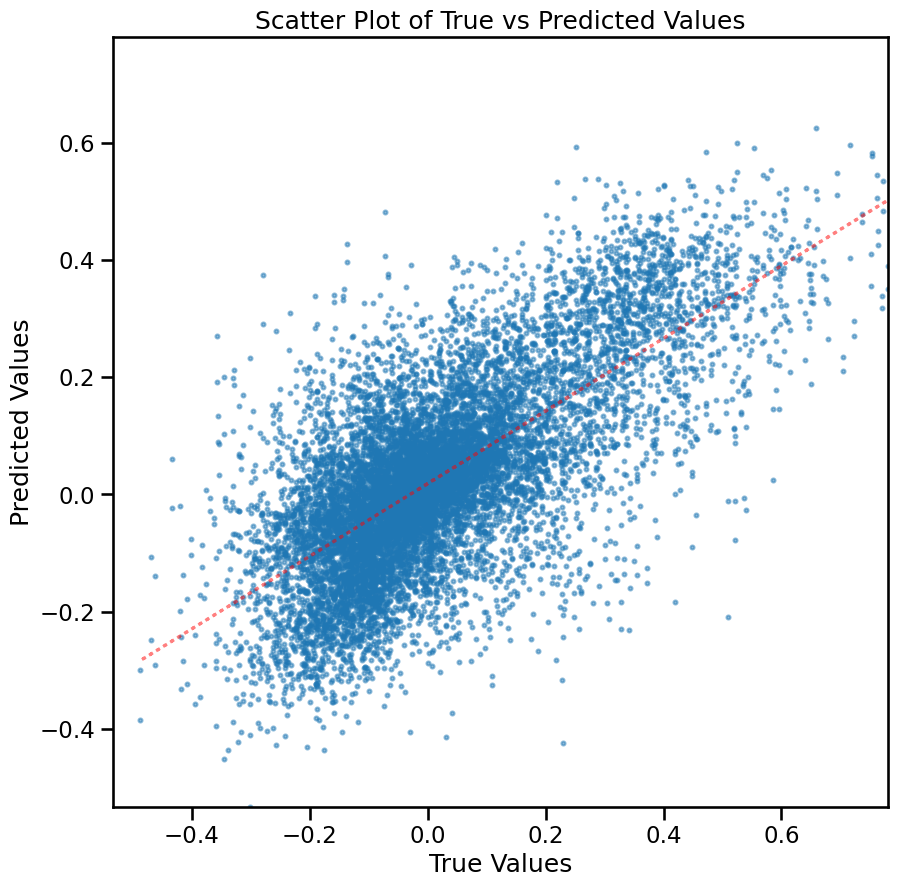

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0052849054, 'mae': 0.05667604, 'r2': 0.8441919023310415, 'pearson_corr': 0.9193486839655447, 'geodesic_distance': 17.797825554619887}
TEST METRICS: {'mse': 0.017677674, 'mae': 0.098153286, 'r2': 0.46175341605641507, 'pearson_corr': 0.7043922780735888, 'geodesic_distance': 11.980863329974444}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▃▃▂▂▃▂▃▃▃▂▂▄▂▄▃▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
train_mse_loss,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01757
train_mse_loss,0.00449


Final evaluation metrics logged successfully.
CPU Usage: 1.3%
RAM Usage: 5.8%
Available RAM: 948.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


54877

In [15]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0342
Best val loss so far at epoch 2: 0.0286
Best val loss so far at epoch 3: 0.0260
Best val loss so far at epoch 4: 0.0225
Epoch 5/50, Train Loss: 0.0375, Val Loss: 0.0208
Best val loss so far at epoch 5: 0.0208
Best val loss so far at epoch 6: 0.0193
Best val loss so far at epoch 8: 0.0168
Best val loss so far at epoch 9: 0.0168
Epoch 10/50, Train Loss: 0.0136, Val Loss: 0.0155
Best val loss so far at epoch 10: 0.0155
Best val loss so far at epoch 12: 0.0142
Best val loss so far at epoch 14: 0.0142
Epoch 15/50, Train Loss: 0.0082, Val Loss: 0.0142
Best val loss so far at epoch 16: 0.0136
Epoch 20/50, Train Loss: 0.0062, Val Loss: 0.0137
Best val loss so far at epoch 21: 0.0134
Best val loss so far at epoch 23: 0.0129
Epoch 25/50, Train Loss: 0.0050, Val Loss: 0.0132
Best val loss so far at epoch 28: 0.0128
Epoch 30/50, Train Loss: 0.0042, Val Loss: 0.0128
Best val loss so fa

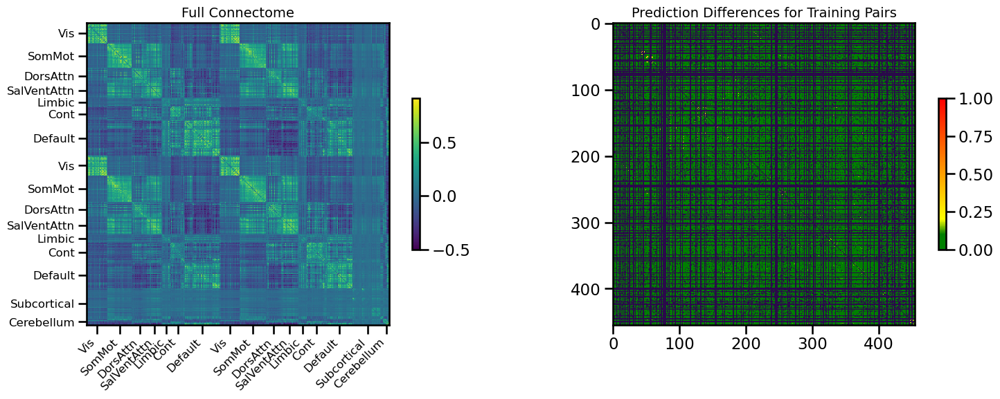

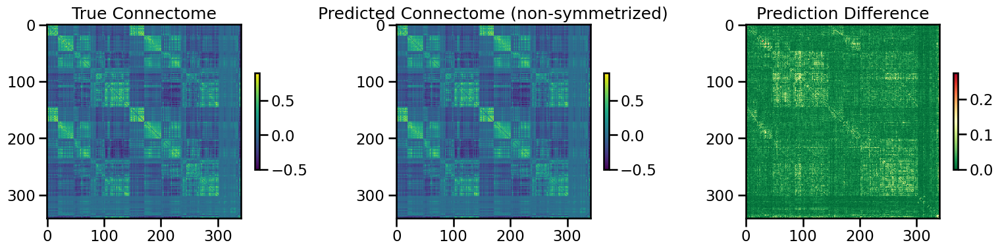

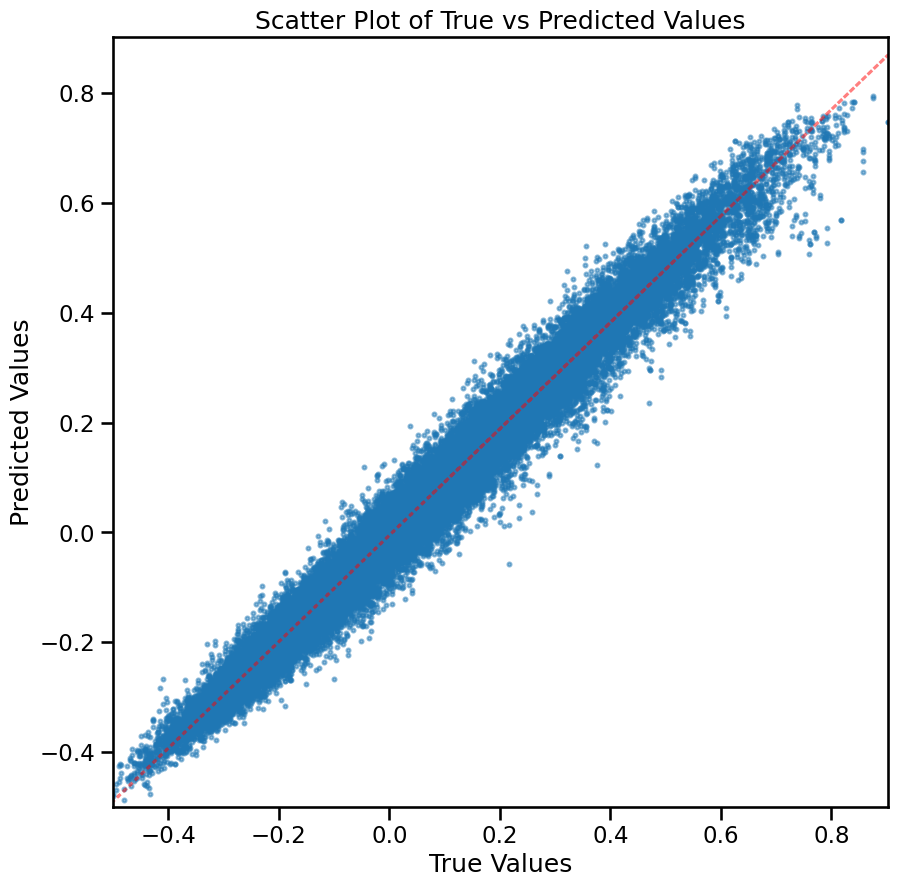

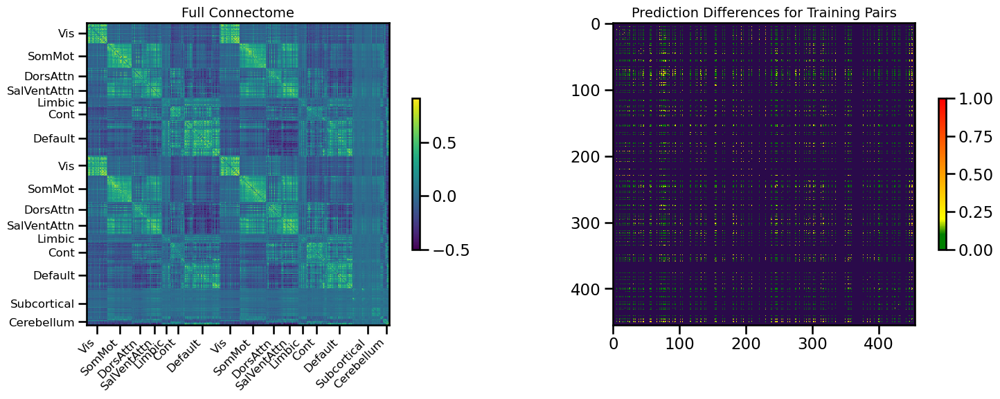

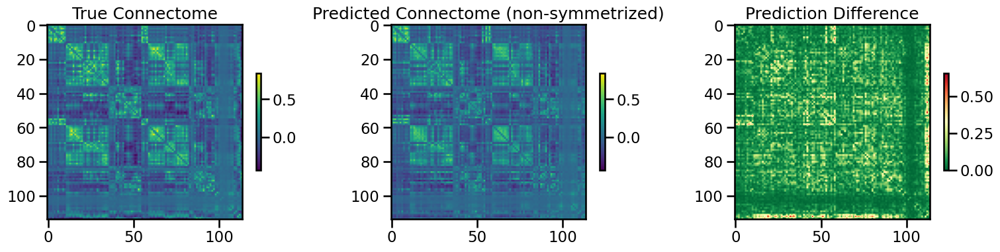

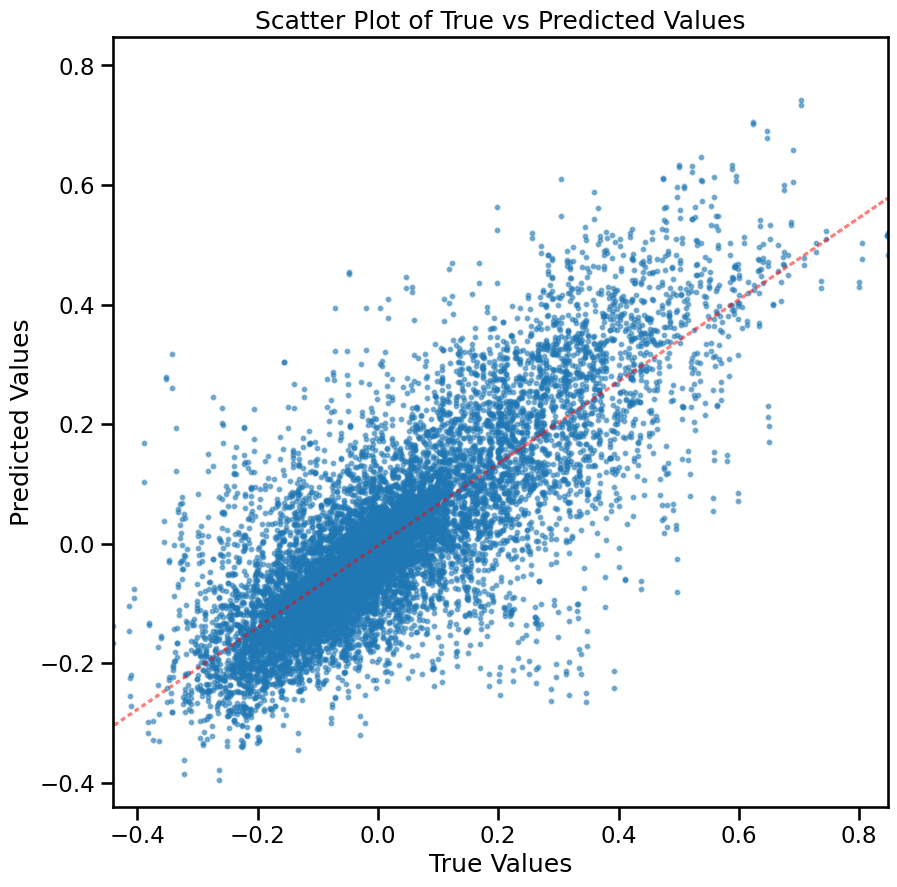

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.00084554445, 'mae': 0.020911, 'r2': 0.9750400241507351, 'pearson_corr': 0.9879905642415893, 'geodesic_distance': 13.138037152587202}
TEST METRICS: {'mse': 0.012308928, 'mae': 0.07623792, 'r2': 0.6240308586970478, 'pearson_corr': 0.7950478905526598, 'geodesic_distance': 10.034671131969395}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▅▄▄▃▂▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▅▁▁▁
train_mse_loss,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01218
train_mse_loss,0.00243


Final evaluation metrics logged successfully.


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0368
Best val loss so far at epoch 2: 0.0305
Best val loss so far at epoch 3: 0.0283
Best val loss so far at epoch 4: 0.0254
Epoch 5/50, Train Loss: 0.0395, Val Loss: 0.0233
Best val loss so far at epoch 5: 0.0233
Best val loss so far at epoch 6: 0.0211
Best val loss so far at epoch 7: 0.0196
Best val loss so far at epoch 8: 0.0177
Best val loss so far at epoch 9: 0.0167
Epoch 10/50, Train Loss: 0.0148, Val Loss: 0.0158
Best val loss so far at epoch 10: 0.0158
Best val loss so far at epoch 11: 0.0155
Best val loss so 

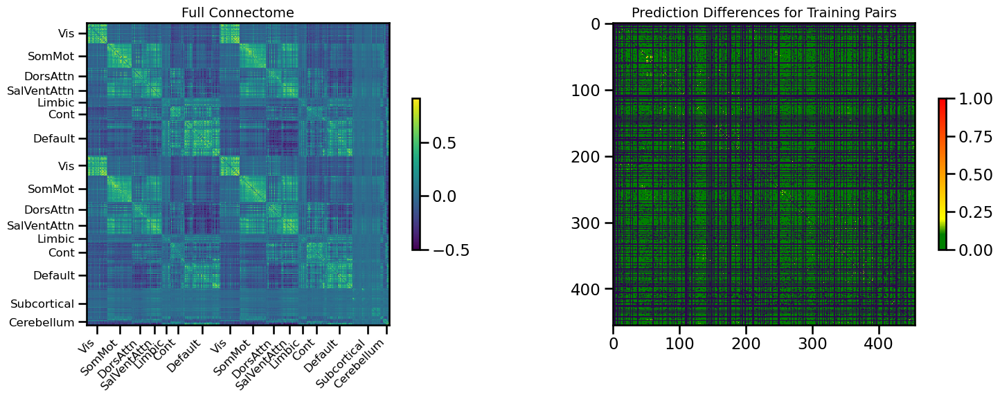

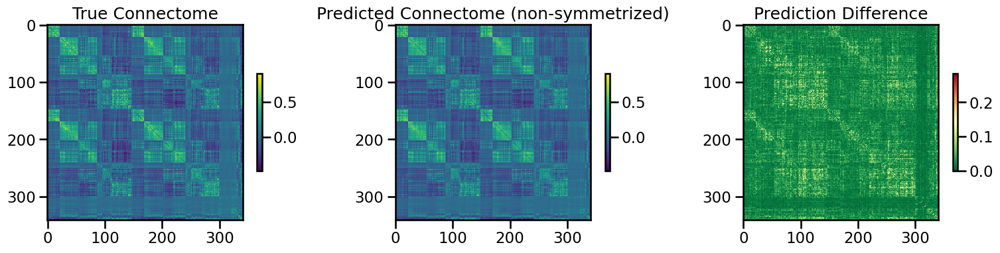

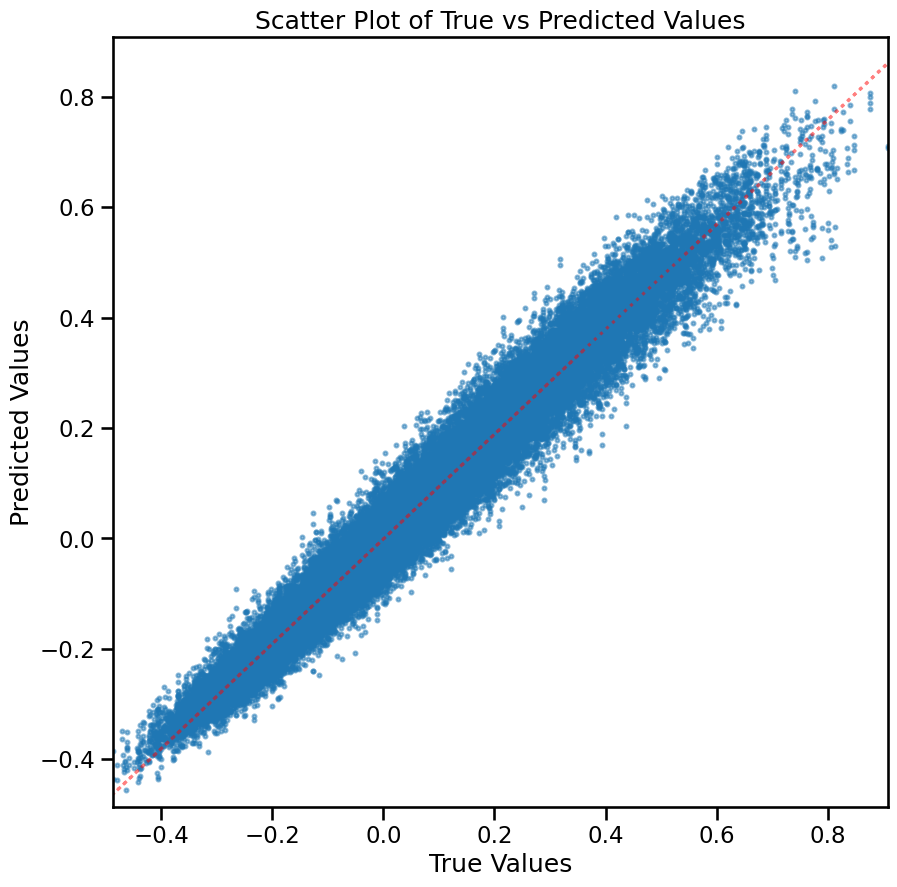

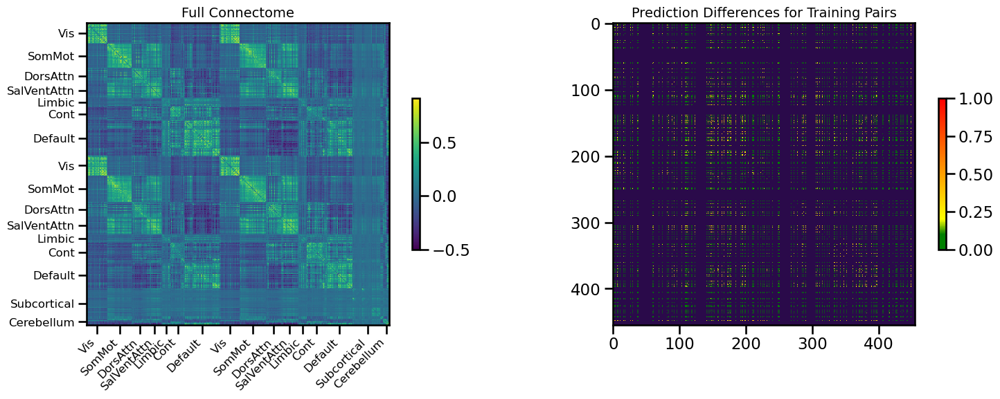

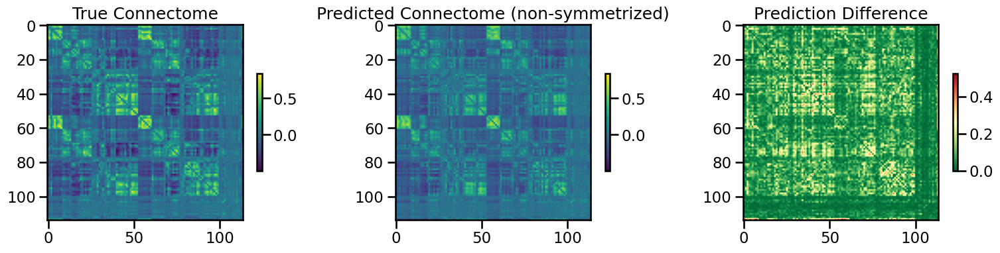

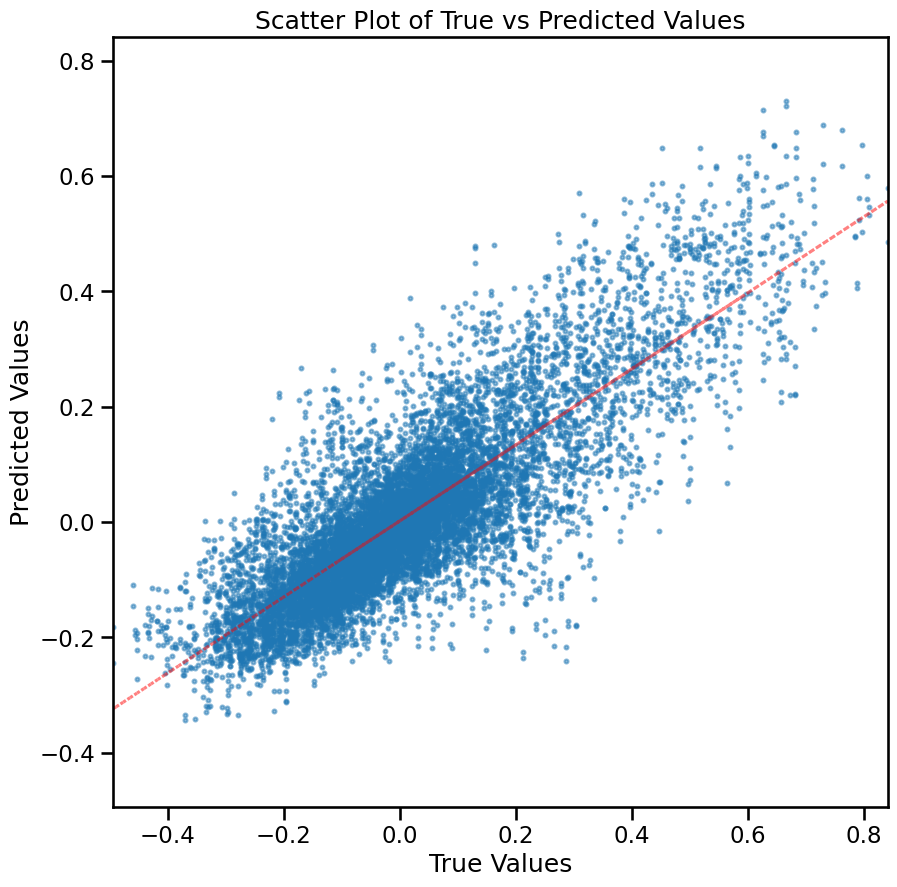

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0011234678, 'mae': 0.024291536, 'r2': 0.9662454150986779, 'pearson_corr': 0.9832171412824097, 'geodesic_distance': 14.114677360093554}
TEST METRICS: {'mse': 0.010924481, 'mae': 0.07390233, 'r2': 0.6882703395375784, 'pearson_corr': 0.8306215855610068, 'geodesic_distance': 9.818500463573336}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import display



best_val_loss,▁
test_mse_loss,█▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.0106
train_mse_loss,0.00267


Final evaluation metrics logged successfully.


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0365
Best val loss so far at epoch 2: 0.0287
Best val loss so far at epoch 3: 0.0241
Best val loss so far at epoch 4: 0.0215
Epoch 5/50, Train Loss: 0.0365, Val Loss: 0.0194
Best val loss so far at epoch 5: 0.0194
Best val loss so far at epoch 6: 0.0182
Best val loss so far at epoch 7: 0.0173
Best val loss so far at epoch 8: 0.0167
Best val loss so far at epoch 9: 0.0166
Epoch 10/50, Train Loss: 0.0130, Val Loss: 0.0149
Best val loss so far at epoch 10: 0.0149
Best val loss so far at epoch 12: 0.0145
Epoch 15/50, Trai

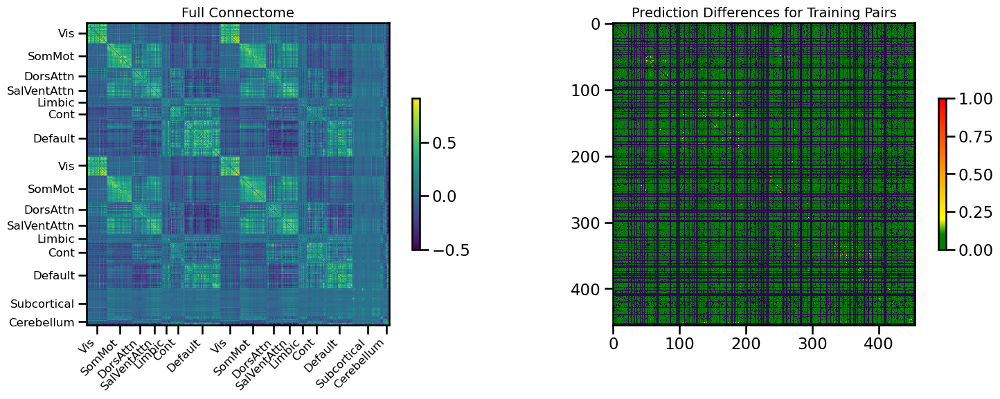

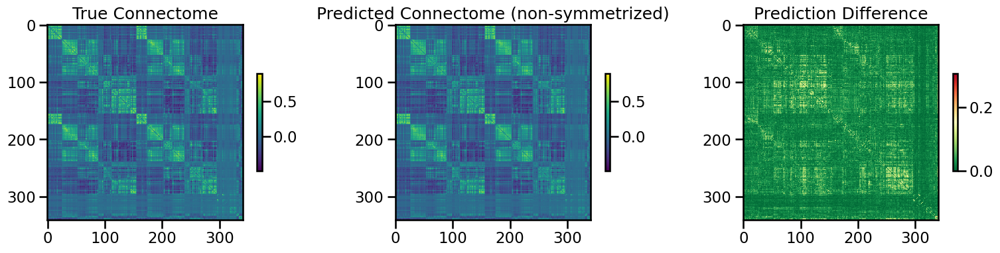

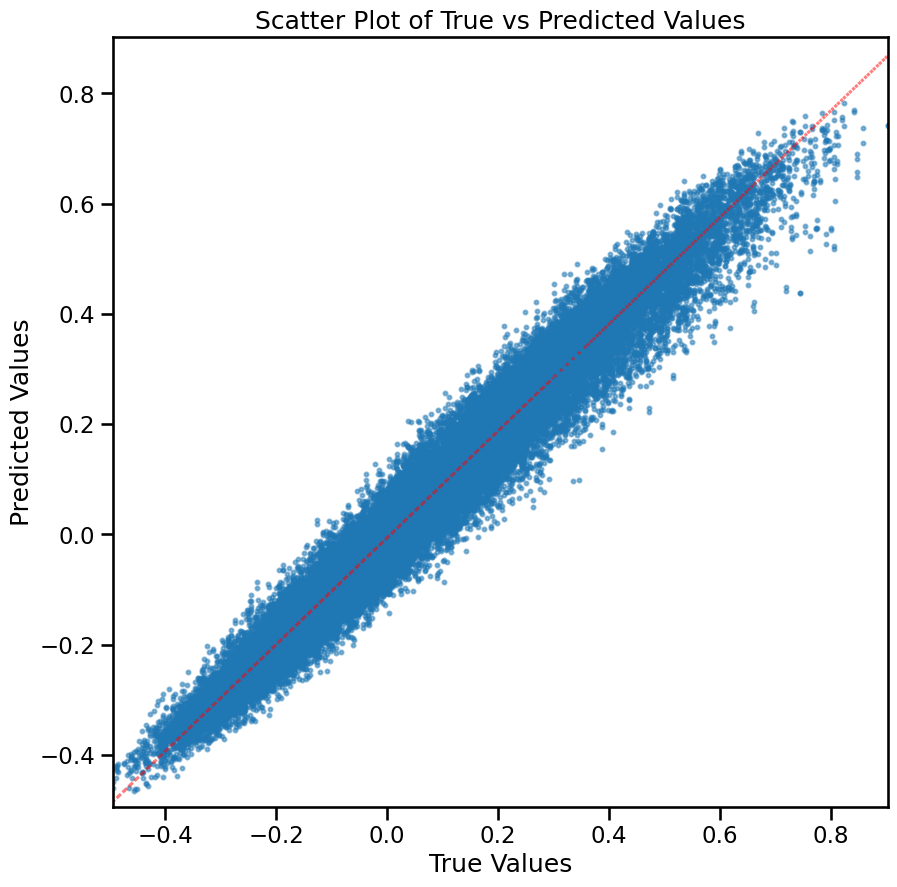

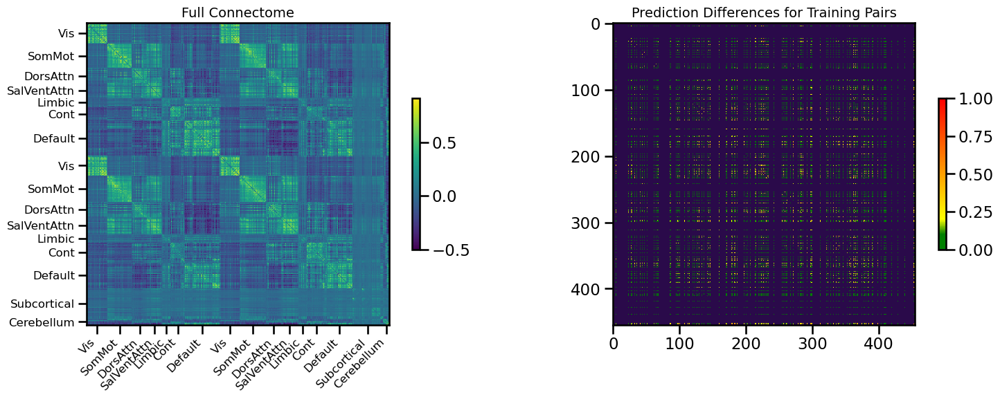

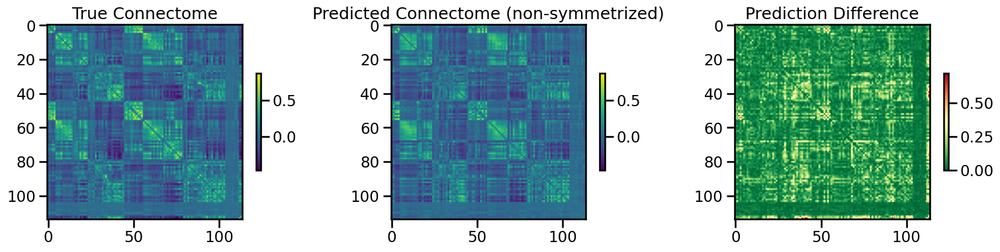

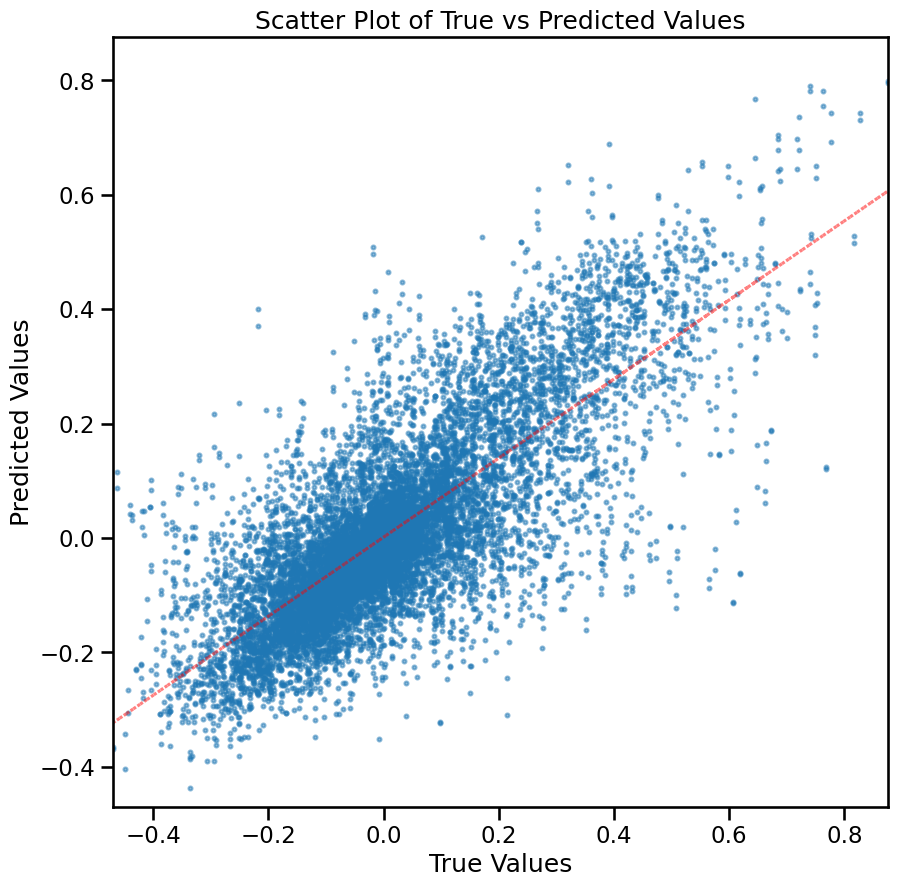

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0011774733, 'mae': 0.024742346, 'r2': 0.9644498472600843, 'pearson_corr': 0.9826970762139043, 'geodesic_distance': 14.264707322034273}
TEST METRICS: {'mse': 0.013846287, 'mae': 0.08110732, 'r2': 0.5922267392295906, 'pearson_corr': 0.7776796773497089, 'geodesic_distance': 10.774069867517385}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01364
train_mse_loss,0.00286


Final evaluation metrics logged successfully.


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0329
Best val loss so far at epoch 2: 0.0292
Best val loss so far at epoch 3: 0.0269
Best val loss so far at epoch 4: 0.0242
Epoch 5/50, Train Loss: 0.0430, Val Loss: 0.0220
Best val loss so far at epoch 5: 0.0220
Best val loss so far at epoch 6: 0.0194
Best val loss so far at epoch 7: 0.0183
Best val loss so far at epoch 8: 0.0177
Best val loss so far at epoch 9: 0.0176
Epoch 10/50, Train Loss: 0.0146, Val Loss: 0.0170
Best val loss so far at epoch 10: 0.0170
Best val loss so far at epoch 12: 0.0154
Best val loss so 

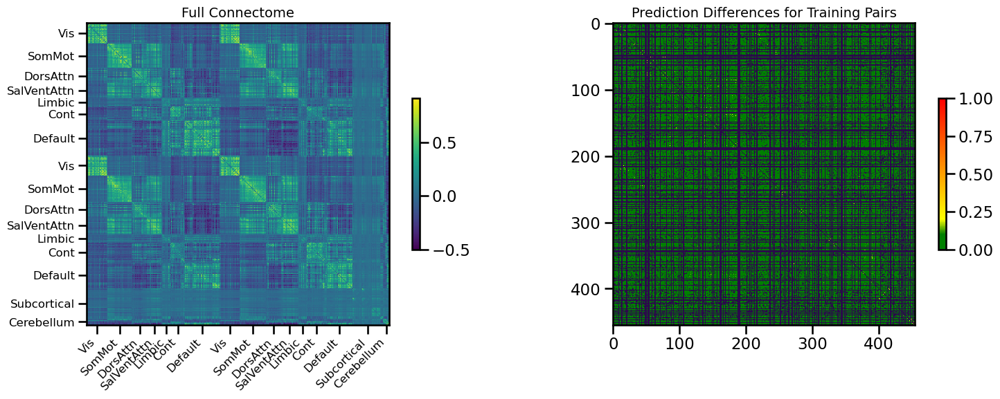

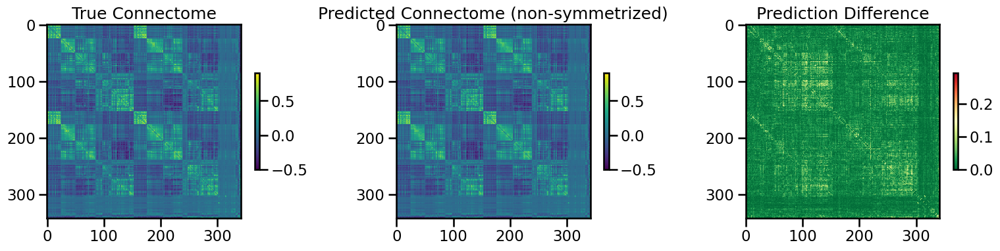

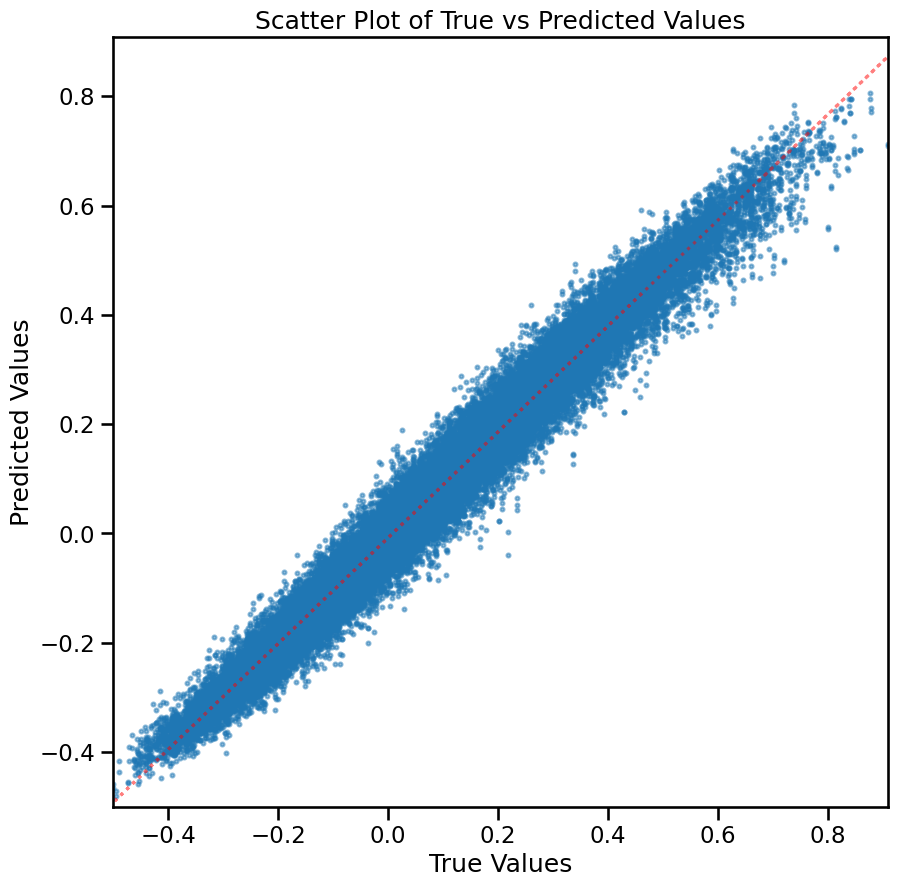

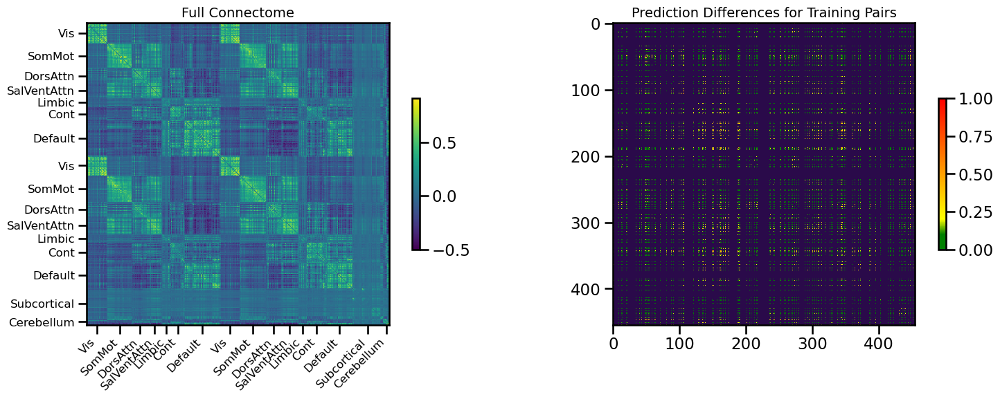

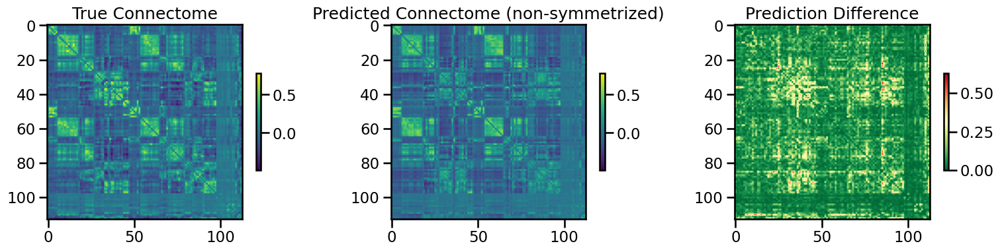

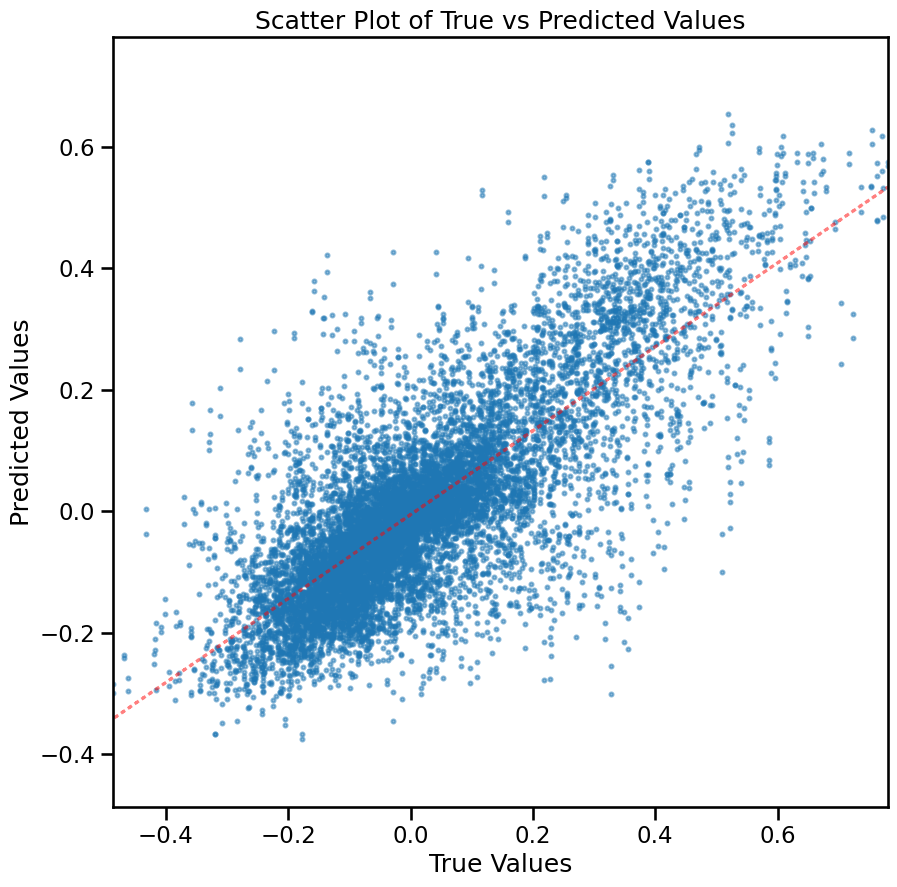

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0008890435, 'mae': 0.02169219, 'r2': 0.9737894700507012, 'pearson_corr': 0.9878274121183488, 'geodesic_distance': 13.984194773920358}
TEST METRICS: {'mse': 0.0132191535, 'mae': 0.079447985, 'r2': 0.5975055986060673, 'pearson_corr': 0.7821147521196045, 'geodesic_distance': 10.45359781557218}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▆▅▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01318
train_mse_loss,0.00232


Final evaluation metrics logged successfully.
CPU Usage: 26.2%
RAM Usage: 24.2%
Available RAM: 763.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  7% |


29629

In [8]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='shared_transformer',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,\
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

In [ ]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='shared_transformer_cls',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spatial

In [ ]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'euclidean': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Network coverage: 100.0% of regions
Network sizes: [113, 113, 113, 116]
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.0293
Best val loss so far at epoch 2: 0.0260
Best val loss so far at epoch 3: 0.0218
Best val loss so far at epoch 4: 0.0181
Epoch 5/50, Train Loss: 0.0394, Val Loss: 0.0163
Best val loss so far at epoch 5: 0.0163
Best val loss so far at epoch 6: 0.0145
Best val loss so far at epoch 7: 0.0142
Best val loss so far at epoch 8: 0.0127
Best val loss so far at epoch 9: 0.0114
Epoch 10/50, Train Loss: 0.0141, Val Loss: 0.0116
Best val loss so far at epoch 11: 0.0103
Best val loss so far at epoch 12: 0.0102
Best val loss so 

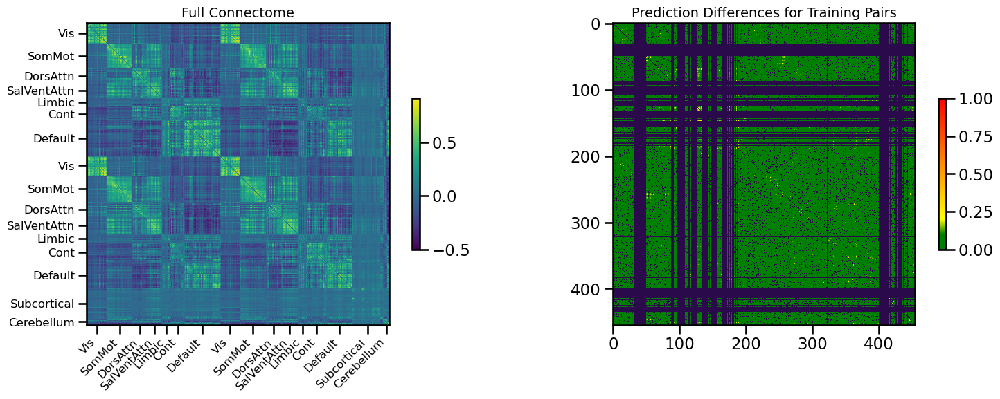

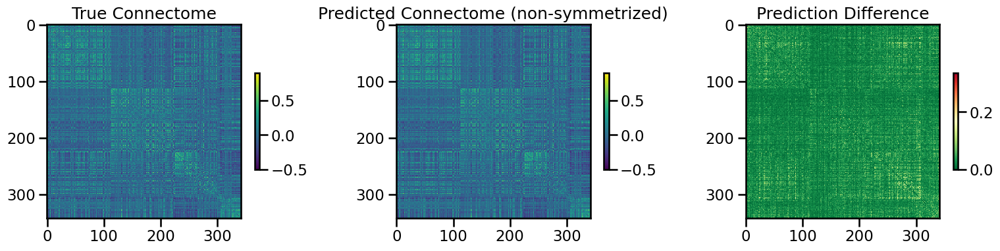

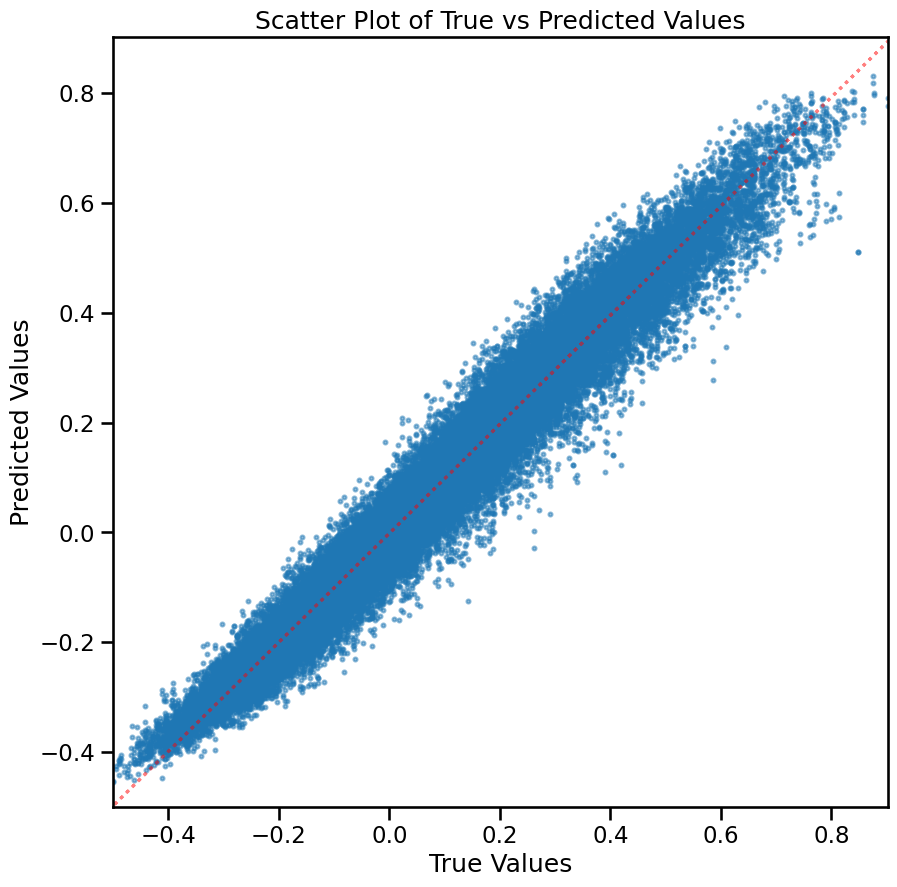

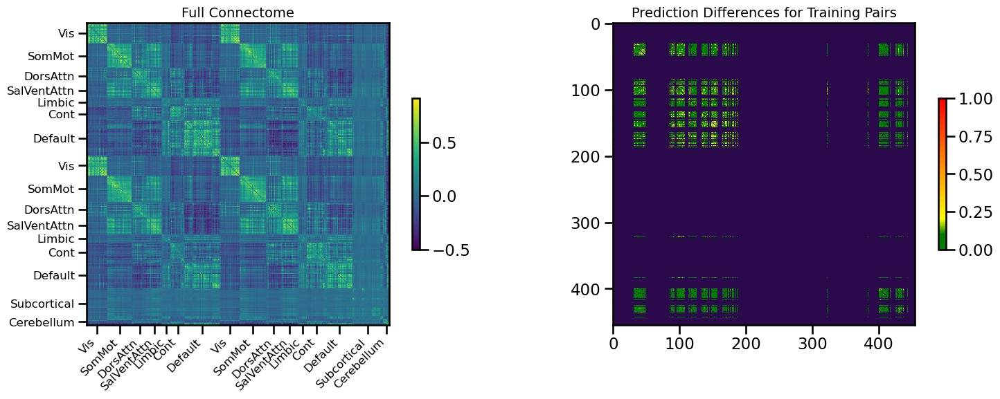

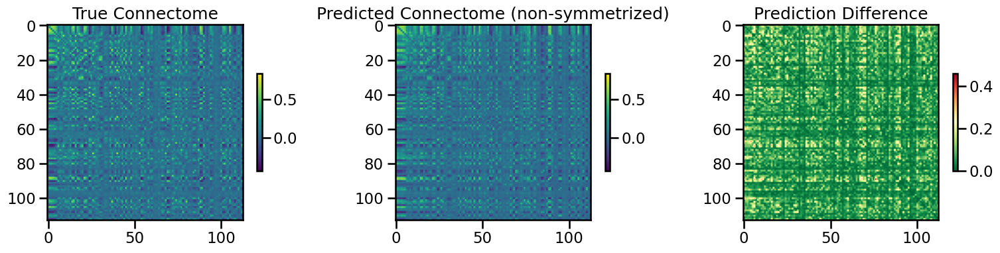

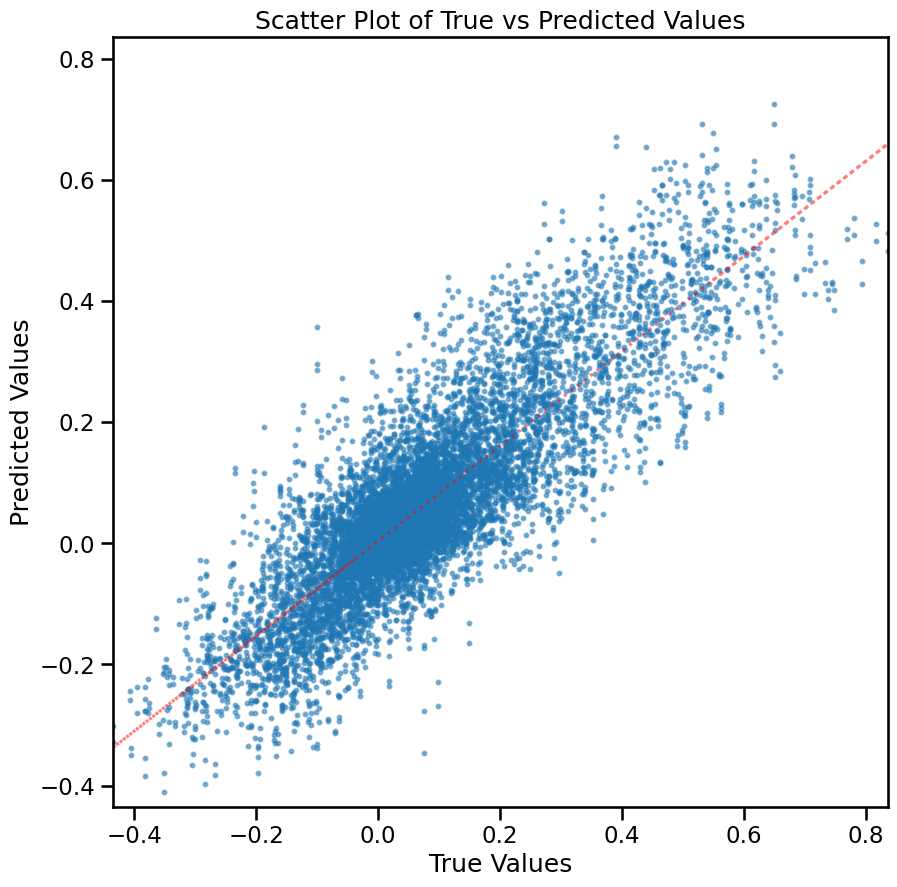

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.0013399317, 'mae': 0.02664497, 'r2': 0.9659625963973675, 'pearson_corr': 0.9832401376784488, 'geodesic_distance': 12.41394737463532}
TEST METRICS: {'mse': 0.00715108, 'mae': 0.060723398, 'r2': 0.7167380707814315, 'pearson_corr': 0.8519125790871848, 'geodesic_distance': 13.189274669000254}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00712
train_mse_loss,0.00307


Final evaluation metrics logged successfully.


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'use_positional_encoding': False, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0552


In [ ]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='shared_transformer',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 105
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (390, 7380)
X_pca shape: (390, 105)
Y_sc shape: (390, 390)
Y_sc_spectralL shape: (390, 455)
Y_sc_spectralA shape: (390, 456)
Y_fc shape: (390, 390)
Coordinates shape: (390, 3)
Y shape (390, 390)
Network coverage: 100.0% of regions
Network sizes: [97, 97, 97, 99]
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0470
Best val loss so far at epoch 3: 0.0437
Best val loss so far at epoch 4: 0.0423
Epoch 5/50, Train Loss: 0.0501, Val Loss: 0.0414
Best val loss so far at epoch 5: 0.0414
Epoch 10/50, Train Loss: 0.0248, Val Loss: 0.0407
Best val loss so far at epoch 10: 0.0407
Epoch 15/50, Train Loss: 0.0151, Val Loss: 0.0555
Epoch 20/50, Train Loss: 0.0092, Val Loss: 0.0429
Epoch 25/50, Train Loss: 0.0067, Val Loss: 0.0416

Early stopping triggered at epoch 25. Restoring best model with Val Loss: 0.0407


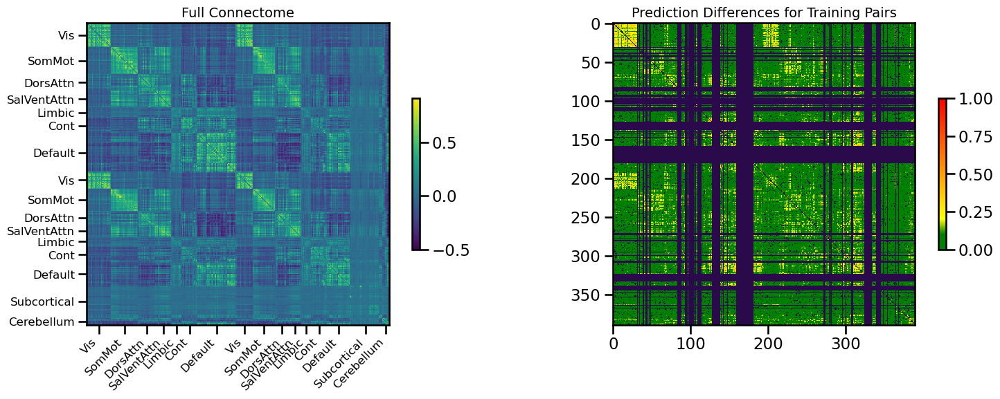

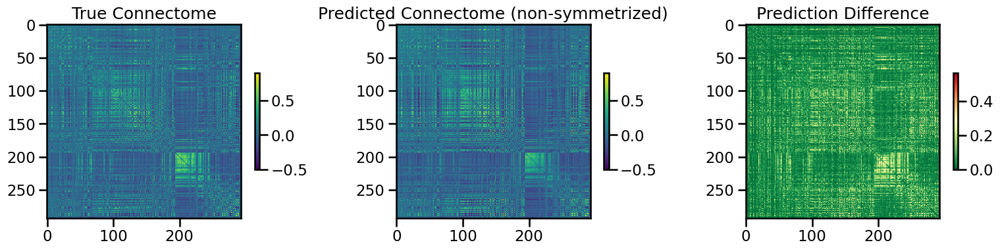

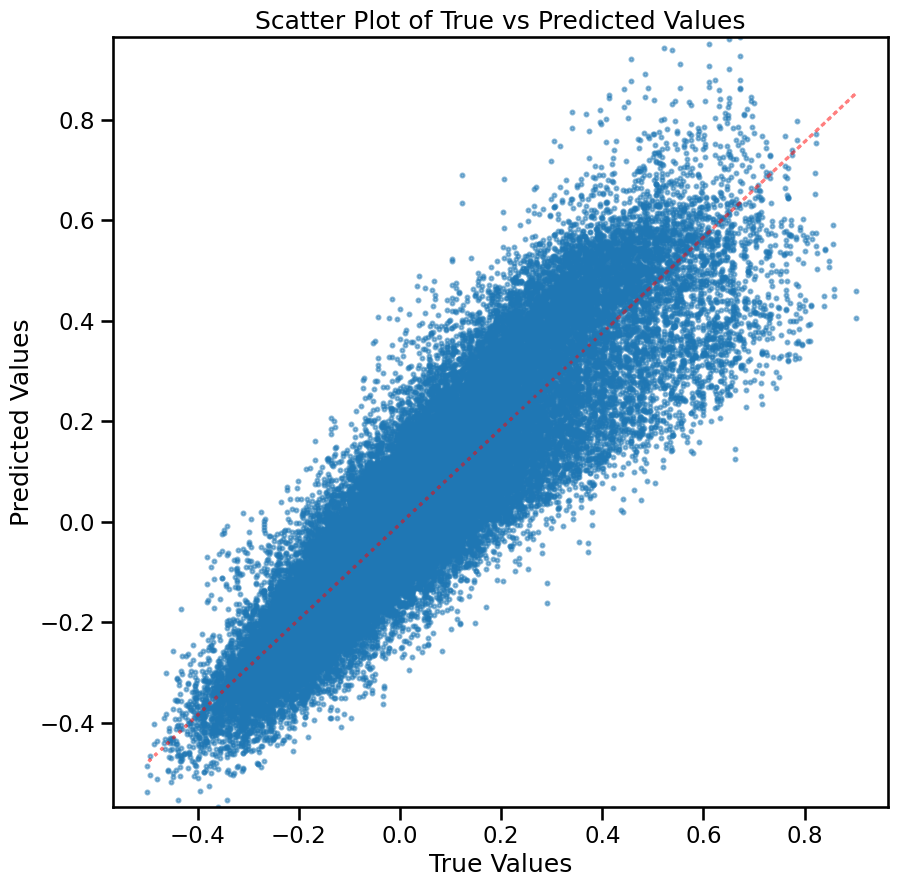

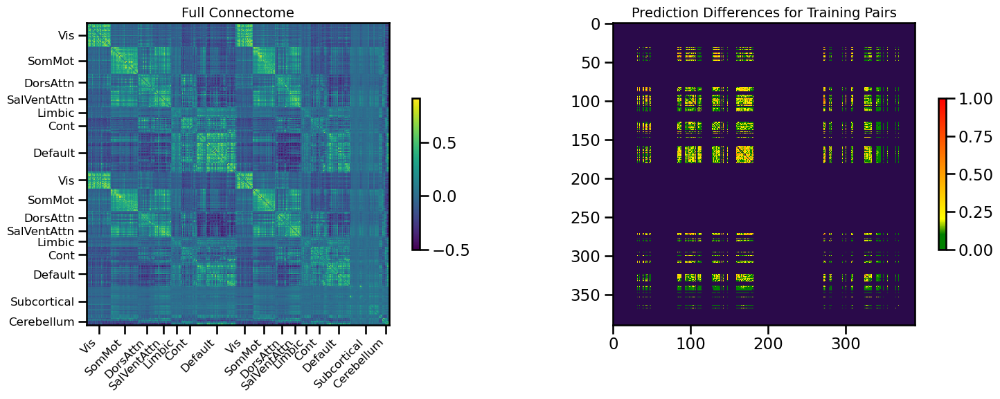

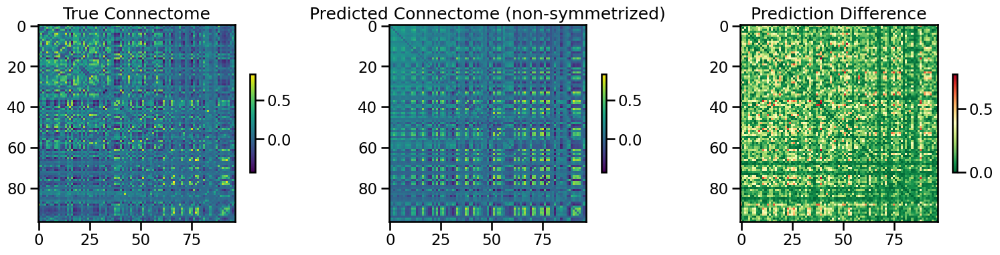

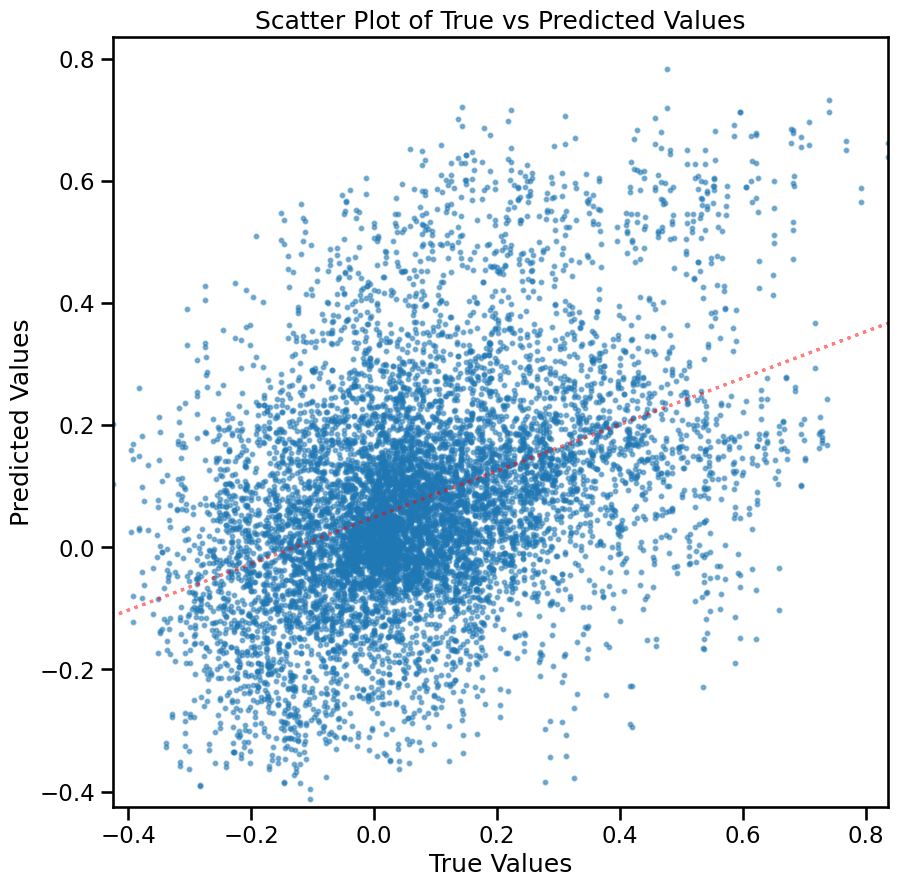

  self.comm = Comm(**args)




TRAIN METRICS: {'mse': 0.007388412, 'mae': 0.061628945, 'r2': 0.7855796581362888, 'pearson_corr': 0.9003190948071405, 'geodesic_distance': 17.73564698261009}
TEST METRICS: {'mse': 0.04226049, 'mae': 0.15615048, 'r2': -0.09546729194596382, 'pearson_corr': 0.41111650200445954, 'geodesic_distance': 13.187692768383648}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}


  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▄▂▂▁▂▃█▃▁▅▄▅█▆▂▃▂▂▂▂▂▄▂▁
train_mse_loss,█▅▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.0416
train_mse_loss,0.00667


Final evaluation metrics logged successfully.


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'use_positional_encoding': False, 'encoder_output_dim': 10, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 50}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.05 GB
Best val loss so far at epoch 1: 0.0302
Best val loss so far at epoch 3: 0.0269
Best val loss so far at epoch 4: 0.0267
Epoch 5/50, Train Loss: 0.0539, Val Loss: 0.0259
Best val loss so far at epoch 5: 0.0259
Best val loss so far at epoch 6: 0.0252
Epoch 10/50, Train Loss: 0.0265, Val Loss: 0.0293
Epoch 15/50, Train Loss: 0.0169, Val Loss: 0.0327
Best val loss so far at epoch 19: 0.0243
Epoch 20/50, Train Loss: 0.0116, Val Loss: 0.0252
Best val loss so far at epoch 23: 0.0235
Epoch 25/50, Train Loss: 0.0087, Val Loss: 0.0268


In [ ]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='shared_transformer_cls',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 3),
              save_sim=False,
              track_wandb=True,
              skip_cv=True
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()